## <font color="Orange"> import libraries</font>

In [1]:
import csv
import datetime
import os
import pickle
import statistics
import time
import warnings
import re
import numpy as np
import pandas as pd
import pandas.tseries.offsets as offsets
import scipy.ndimage
import lightgbm as lgb
import xgboost as xgb
import pywt 
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_validate
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR
from sklearn.model_selection import KFold, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from keras.utils import np_utils
from keras.optimizers import Adam
from keras import backend as K
from keras.models import Sequential, Model
from keras.callbacks import EarlyStopping 
from keras.layers import Input, Conv2D, BatchNormalization, ReLU, Flatten, Dense, Add, Dropout, Activation, MaxPooling2D
import matplotlib.pyplot as plt

from sklearn.metrics import accuracy_score
from sklearn.metrics import log_loss
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold, train_test_split

import seaborn as sns

In [2]:
# pd.set_option('display.max_columns', 100)
# pd.set_option('display.max_rows', 200)

## <font color="Orange">  data loading</font>

In [3]:
def amend_df(_df):
    _df = _df.dropna()
    _df = _df[['CSI_DATA','timestamp']]
    _df['timestamp'] = _df['timestamp'].astype('float64')
    _df['timestamp'] = list(map(datetime.datetime.fromtimestamp, _df['timestamp']))
    _df['timestamp'] = _df['timestamp'].round('1s')
    return _df

 #### <font color="MediumTurquoise">  ap</font>

In [4]:
_df_ap_org_1 = pd.read_csv('./data/0209/ap_1.csv',  error_bad_lines=False)
_df_ap_org_2 = pd.read_csv('./data/0209/ap_2.csv',  error_bad_lines=False)
_df_ap = pd.concat([_df_ap_org_1, _df_ap_org_2], ignore_index=True)

b'Skipping line 124130: expected 27 fields, saw 92\nSkipping line 124139: expected 27 fields, saw 51\nSkipping line 124179: expected 27 fields, saw 77\n'
b'Skipping line 140236: expected 27 fields, saw 52\n'
b'Skipping line 366679: expected 27 fields, saw 49\nSkipping line 367434: expected 27 fields, saw 52\nSkipping line 367438: expected 27 fields, saw 52\nSkipping line 367818: expected 27 fields, saw 52\nSkipping line 368443: expected 27 fields, saw 52\nSkipping line 368566: expected 27 fields, saw 52\nSkipping line 368661: expected 27 fields, saw 52\nSkipping line 368683: expected 27 fields, saw 52\nSkipping line 369544: expected 27 fields, saw 52\nSkipping line 369688: expected 27 fields, saw 52\nSkipping line 369689: expected 27 fields, saw 52\nSkipping line 369703: expected 27 fields, saw 52\nSkipping line 369705: expected 27 fields, saw 52\nSkipping line 369706: expected 27 fields, saw 52\nSkipping line 369707: expected 27 fields, saw 52\nSkipping line 369921: expected 27 fields

In [5]:
_df_ap = amend_df(_df_ap)

 #### <font color="MediumTurquoise">  mp</font>

In [6]:
_df_mp_org_1 = pd.read_csv('./data/0209/mp_3.csv',  error_bad_lines=False)
_df_mp_org_2 = pd.read_csv('./data/0209/mp_4.csv',  error_bad_lines=False)
_df_mp_org_3 = pd.read_csv('./data/0209/mp_5.csv',  error_bad_lines=False)
_df_mp = pd.concat([_df_mp_org_1, _df_mp_org_2, _df_mp_org_3], ignore_index=True)

b'Skipping line 144558: expected 27 fields, saw 49\nSkipping line 158698: expected 27 fields, saw 44\n'
b'Skipping line 213046: expected 27 fields, saw 52\n'
b'Skipping line 237302: expected 27 fields, saw 29\n'
b'Skipping line 290413: expected 27 fields, saw 44\nSkipping line 290614: expected 27 fields, saw 52\n'
/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (21) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (23) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [7]:
_df_mp = amend_df(_df_mp)

 #### <font color="MediumTurquoise"> _df_ap0127(test用)</font>

In [8]:
_df_ap0127 = pd.read_csv('./data/0127/ap.csv',  error_bad_lines=False)

b'Skipping line 23612: expected 27 fields, saw 52\nSkipping line 26425: expected 27 fields, saw 38\n'


In [9]:
_df_ap0127 = amend_df(_df_ap0127)

## <font color="Orange">  preprocessing</font>

 ## <font color="MediumTurquoise">func </font>

 #### <font color="MediumTurquoise"> csi_to_numpy</font>

In [10]:
def csi_to_numpy(_x):
    _x = _x[1:-2]
    _x_box = re.split(' ', _x)
    
    if len(_x_box) != 128:
        return -999
    
    else:
        for _ in _x_box:
            try:
                _ = int(_)
            except:
                _ = 0
        return _x_box

 #### <font color="MediumTurquoise"> divide_csi</font>

In [11]:
def divide_csi(_df):
    col_csi = ['csi_{}'.format(i+1) for i in range(128)]

    _csi_np = _df['CSI_DATA'].values
    _csi_ls = []
    for _ls in _csi_np:
        _ls_int = []
        for n in _ls:
            try:
                _ls_int.append(int(n))
            except:
                _ls_int.append(0)
                print('error : {}'.format(n))
        _csi_ls.append(_ls_int)
    _csi_ls = np.array(_csi_ls)
    _df[col_csi] = _csi_ls
    
    _df.drop('CSI_DATA',axis=1, inplace=True)
    _df.sort_values('timestamp', inplace=True)

 
    return _df

 #### <font color="MediumTurquoise">  filter time</font>

In [12]:
def filter_time(_df):
    return _df[(_df['timestamp']>= '2021-02-09 20:20:17') & (_df['timestamp']<= '2021-02-09 22:11:10' )]

 #### <font color="MediumTurquoise">  merge label data</font>

In [13]:
def merge_label_data(_df):
    _df = pd.merge_asof(_df, _df_timestamp, on='timestamp', direction = 'nearest')
    return _df

 #### <font color="MediumTurquoise"> filter 01234 from _df(0207)</font>

0,1,2,3,4 のラベルをtrainデータに用い、回帰モデルを作って、
5,6 をtestデータにして、ちゃんと回帰ができるかを確かめる

In [14]:
def filter_01234(_df):
    return (_df[(_df['label'] >= 0) & (_df['label'] <= 4)] ,_df[(_df['label'] >= 5) & (_df['label'] <= 6)])

----------------
## <font color="MediumTurquoise">実践</font>

 #### <font color="MediumTurquoise"> csi_to_numpy</font>

In [15]:
_df_ap['CSI_DATA'] = _df_ap['CSI_DATA'].map(csi_to_numpy)
_df_mp['CSI_DATA'] = _df_mp['CSI_DATA'].map(csi_to_numpy)
_df_ap0127['CSI_DATA'] = _df_ap0127['CSI_DATA'].map(csi_to_numpy)

In [16]:
_df_ap= _df_ap[_df_ap['CSI_DATA'] != -999]
_df_mp= _df_mp[_df_mp['CSI_DATA'] != -999]
_df_ap0127= _df_ap0127[_df_ap0127['CSI_DATA'] != -999]

In [17]:
_df_ap.dropna(inplace=True)
_df_mp.dropna(inplace=True)
_df_ap0127.dropna(inplace=True)

 #### <font color="MediumTurquoise"> divide_csi</font>

In [18]:
_df_ap = divide_csi(_df_ap)

error : 
error : 
error : 


In [19]:
_df_mp = divide_csi(_df_mp)

In [20]:
_df_ap0127 = divide_csi(_df_ap0127)

 #### <font color="MediumTurquoise">  bysecond</font>

(今回は使わない)

In [21]:
_df_ap_bysecond = _df_ap.groupby('timestamp',as_index=False).agg(np.mean)
_df_mp_bysecond = _df_mp.groupby('timestamp',as_index=False).agg(np.mean)
_df_ap0127_bysecond = _df_ap0127.groupby('timestamp',as_index=False).agg(np.mean)

In [155]:
_df_ap = _df_ap_bysecond
_df_mp = _df_mp_bysecond

 #### <font color="MediumTurquoise">  filter time (0209)</font>

In [156]:
_df_ap = filter_time(_df_ap)
_df_mp = filter_time(_df_mp)

 #### <font color="MediumTurquoise">  merge ap & mp → join (0209)</font>

In [157]:
if len(_df_ap) >= len(_df_mp):
    _df_join = pd.merge_asof(_df_ap, _df_mp, on='timestamp', suffixes=('_ap','_mp'), direction='forward') 
else:
    _df_join = pd.merge_asof(_df_mp, _df_ap, on='timestamp', suffixes=('_mp','_ap'), direction='backward') 

In [158]:
# _df_join.head()

 #### <font color="MediumTurquoise">  label (0209)</font>

In [159]:
start_timestamp = pd.to_datetime('2021-02-09 00:00:00')

timestamp_box = [start_timestamp]

ts = start_timestamp
for _ in range(6653):
    ts = ts + offsets.Second(1)
    timestamp_box.append(ts)

timestamp_box = np.array(timestamp_box)
_df_timestamp = pd.DataFrame(timestamp_box, columns=['timestamp'])
_df_timestamp['label'] = 0

In [160]:
_df_label = pd.read_csv('./data/0209/label.csv',  error_bad_lines=False)

In [161]:
_df_label['delta_time'] = _df_label['hour']*3600 +_df_label['minute']*60 + _df_label['second']

_df_np = _df_label[['label','delta_time']].values
label_box = []
for i in range(_df_np.shape[0]):
    try:
        n =_df_np[i+1][1]-_df_np[i][1]
        for _ in range(n):
            label_box.append(_df_np[i][0])
    except IndexError:
        break
        
label_box = np.array(label_box)

In [162]:
_df_timestamp['label'] = label_box

In [163]:
_df_timestamp['timestamp'] = _df_timestamp['timestamp'] + offsets.Hour(20)
_df_timestamp['timestamp'] = _df_timestamp['timestamp'] + offsets.Minute(20)
_df_timestamp['timestamp'] = _df_timestamp['timestamp'] + offsets.Second(17)

In [164]:
#_df_timestamp.head()

 #### <font color="MediumTurquoise">  merge label data (0209)</font>

In [165]:
_df_ap = merge_label_data(_df_ap)
_df_mp = merge_label_data(_df_mp)
_df_join = merge_label_data(_df_join)

In [166]:
_df_join.dropna(inplace=True)

In [167]:
#_df_join.head()

------------------------

 #### <font color="MediumTurquoise"> label(0127)</font>

In [168]:
#0人
_df_ap0127_0 = _df_ap0127_bysecond[_df_ap0127_bysecond['timestamp'] > '2021-01-27 21:39:30']
_df_ap0127_0 = _df_ap0127_0[_df_ap0127_0['timestamp'] < '2021-01-27 21:43:31']
_df_ap0127_0 = _df_ap0127_0.reset_index(drop=True)
_df_ap0127_0['label'] = 0

#1人
_df_ap0127_1 = _df_ap0127_bysecond[_df_ap0127_bysecond['timestamp'] >  '2021-01-27 21:44:30']
_df_ap0127_1 = _df_ap0127_1[_df_ap0127_1['timestamp'] < '2021-01-27 21:48:31']
_df_ap0127_1 = _df_ap0127_1.reset_index(drop=True)
_df_ap0127_1['label'] = 1

#2人
_df_ap0127_2 = _df_ap0127_bysecond[_df_ap0127_bysecond['timestamp'] >  '2021-01-27 21:49:30']
_df_ap0127_2 = _df_ap0127_2[_df_ap0127_2['timestamp'] < '2021-01-27 21:53:31']
_df_ap0127_2 = _df_ap0127_2.reset_index(drop=True)
_df_ap0127_2['label'] = 2

#3人
_df_ap0127_3 = _df_ap0127_bysecond[_df_ap0127_bysecond['timestamp'] >  '2021-01-27 21:54:30']
_df_ap0127_3 = _df_ap0127_3[_df_ap0127_3['timestamp'] <  '2021-01-27 21:58:31']
_df_ap0127_3 = _df_ap0127_3.reset_index(drop=True)
_df_ap0127_3['label'] = 3

In [169]:
_df_ap0127 = pd.concat([_df_ap0127_0, _df_ap0127_1, _df_ap0127_2, _df_ap0127_3])

---------------

 #### <font color="MediumTurquoise"> re-index</font>

In [170]:
col_reindex = ['timestamp', 'label']
for _ in range(128):
    col_reindex.append('csi_{}'.format(_+1))

In [171]:
_df_ap = _df_ap.reindex(columns=col_reindex)
_df_mp = _df_mp.reindex(columns=col_reindex)

_df_ap0127 = _df_ap0127.reindex(columns=col_reindex)

In [172]:
col_reindex = ['timestamp', 'label']

for _ in range(128):
    col_reindex.append('csi_{}_ap'.format(_+1))
for _ in range(128):
    col_reindex.append('csi_{}_mp'.format(_+1))

In [173]:
_df_join = _df_join.reindex(columns=col_reindex)

In [174]:
# _df_ap.head()

In [175]:
# _df_ap0127.head()

In [176]:
# _df_join.head()

 #### <font color="MediumTurquoise"> filter 01234 from _df(0207)</font>

0,1,2,3,4 のラベルをtrainデータに用い、回帰モデルを作って、
5,6 をtestデータにして、ちゃんと回帰ができるかを確かめる

In [177]:
_df_ap_04, _df_ap_56 = filter_01234(_df_ap)
_df_mp_04, _df_mp_56 = filter_01234(_df_mp)
_df_join_04, _df_join_56 = filter_01234(_df_join)

In [178]:
 _df_join.head()

,timestamp,label,csi_1_ap,csi_2_ap,csi_3_ap,csi_4_ap,csi_5_ap,csi_6_ap,csi_7_ap,csi_8_ap,...,csi_119_mp,csi_120_mp,csi_121_mp,csi_122_mp,csi_123_mp,csi_124_mp,csi_125_mp,csi_126_mp,csi_127_mp,csi_128_mp
0,2021-02-09 20:33:18,2,84.000000,-64.000000,4.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2021-02-09 20:33:19,2,83.210084,-61.579832,3.966387,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2021-02-09 20:33:20,2,83.973684,-64.421053,4.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2021-02-09 20:33:21,2,83.986667,-64.213333,4.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2021-02-09 20:33:22,2,84.000000,-64.000000,4.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## <font color="Orange"> EDA</font>

In [46]:
_df_join.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 590432 entries, 0 to 590431
Columns: 258 entries, timestamp to csi_128_mp
dtypes: datetime64[ns](1), float64(128), int64(129)
memory usage: 1.1 GB


In [47]:
_df_join.describe()

,label,csi_1_ap,csi_2_ap,csi_3_ap,csi_4_ap,csi_5_ap,csi_6_ap,csi_7_ap,csi_8_ap,csi_9_ap,...,csi_119_mp,csi_120_mp,csi_121_mp,csi_122_mp,csi_123_mp,csi_124_mp,csi_125_mp,csi_126_mp,csi_127_mp,csi_128_mp
count,590432.000000,590432.000000,590432.000000,590432.000000,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0,...,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0,590432.0
mean,3.346055,84.001904,-63.990353,4.000213,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,1.840323,0.336218,1.530397,0.027236,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.000000,37.000000,-96.000000,2.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,2.000000,84.000000,-64.000000,4.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,3.000000,84.000000,-64.000000,4.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,5.000000,84.000000,-64.000000,4.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,6.000000,118.000000,96.000000,7.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [111]:
import sys, pprint

In [112]:
pprint.pprint(sys.path)

['/usr/lib/python36.zip',
 '/usr/lib/python3.6',
 '/usr/lib/python3.6/lib-dynload',
 '',
 '/usr/local/lib/python3.6/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/IPython/extensions',
 '/root/.ipython']


In [49]:
#plt.hist(_df_join['csi_1_ap'],bins = )

In [50]:
#import nimfa

In [51]:
#pmf_c1a = Pmf(_df_join['csi_1_ap'], normalize = False)
#pmf_c1a.head()

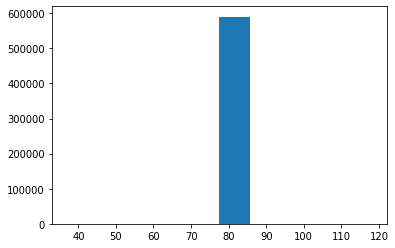

In [106]:
c1a = _df_join['csi_1_ap']
plt.hist(c1a, label='csi_1_ap')
plt.show()

In [107]:
c1a.head()

0    84
1    84
2    84
3    84
4    84
Name: csi_1_ap, dtype: int64

In [108]:
c1a.unique()

array([ 84,  82, 118,  37])

In [109]:
c1a.value_counts()

84     590301
82         79
118        46
37          6
Name: csi_1_ap, dtype: int64

In [114]:
from empiricaldist import Pmf


In [116]:
pmf_c1a = Pmf(c1a)

In [117]:
pmf_c1a.head()

,probs
0,84
1,84
2,84


In [118]:
pmf_c1a[12]

84

In [122]:
pmf_c1a = Pmf.from_seq(c1a, normalize=True)

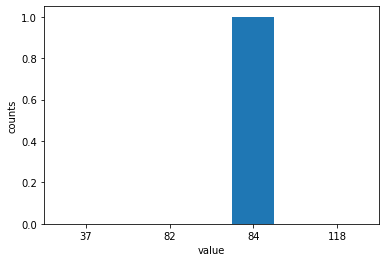

In [123]:
pmf_c1a.bar(label='c1a')
plt.xlabel('value')
plt.ylabel('counts')
plt.show()

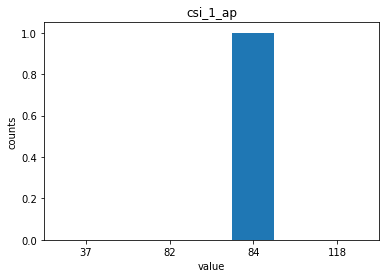

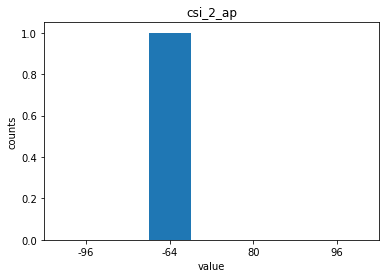

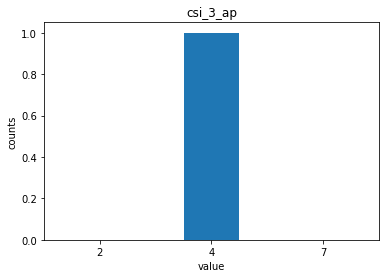

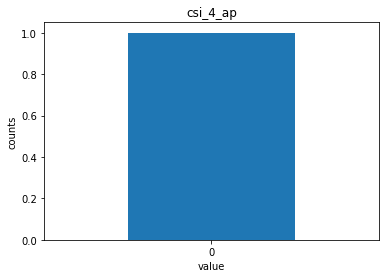

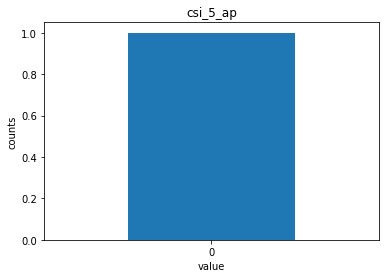

...

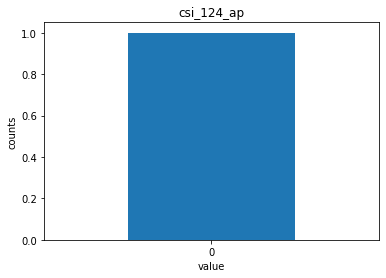

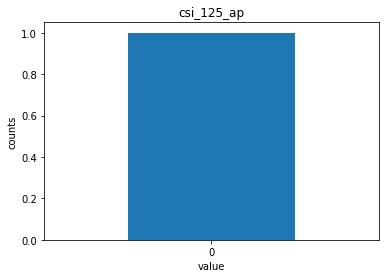

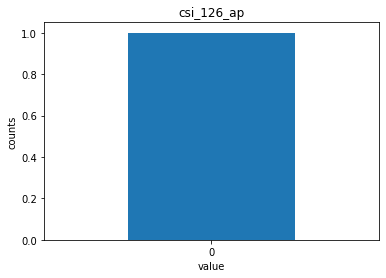

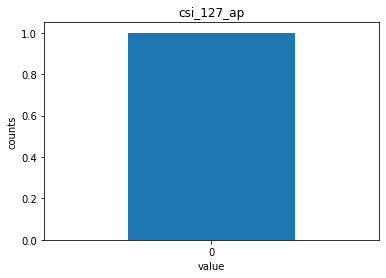

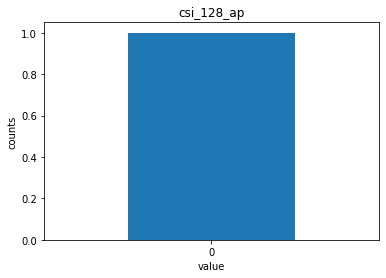

In [136]:
for i in range(128):
    cia = _df_join['csi_{}_ap'.format(i+1)]
    pmf_cia = Pmf.from_seq(cia, normalize=True)
    pmf_cia.bar(label='c{}a'.format(i+1))
    plt.title('csi_{}_ap'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.show()

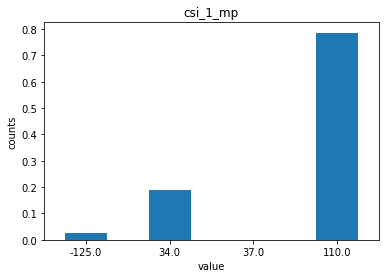

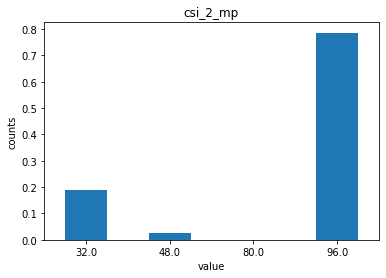

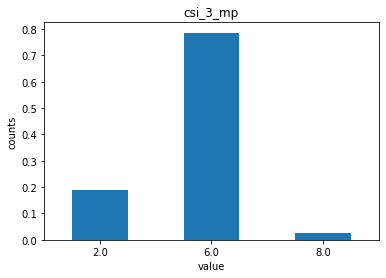

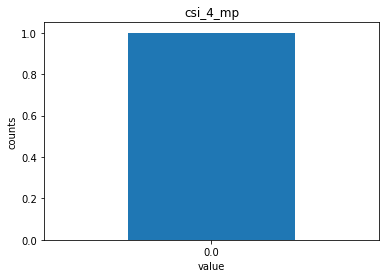

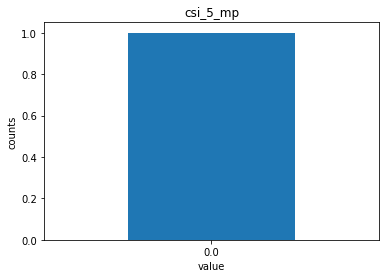

...

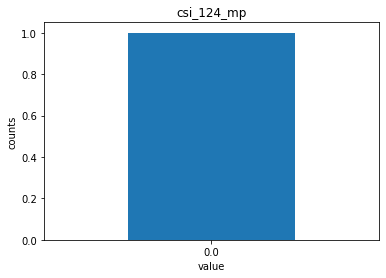

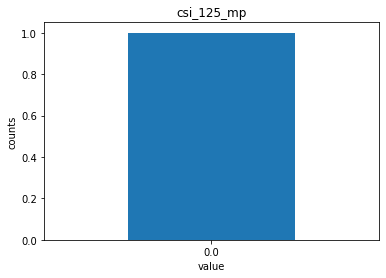

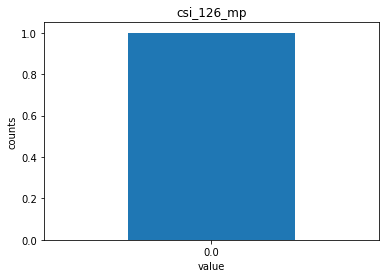

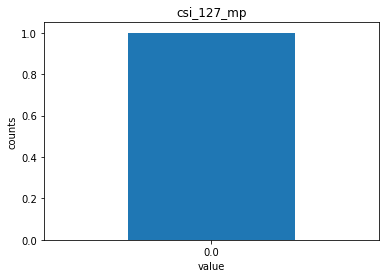

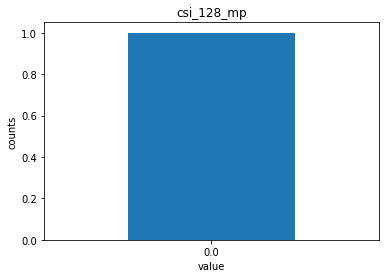

In [137]:
for i in range(128):
    cim = _df_join['csi_{}_mp'.format(i+1)]
    pmf_cim = Pmf.from_seq(cim, normalize=True)
    pmf_cim.bar(label='c{}m'.format(i+1))
    plt.title('csi_{}_mp'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.show()

In [129]:
from empiricaldist import Cdf

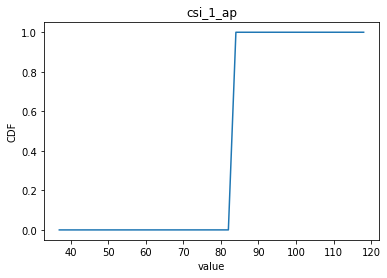

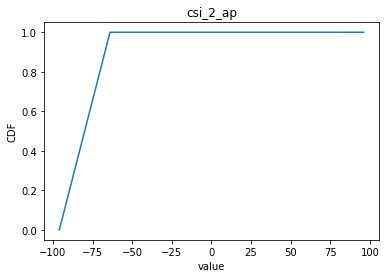

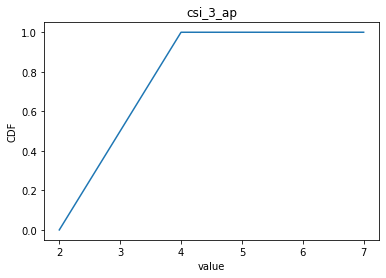

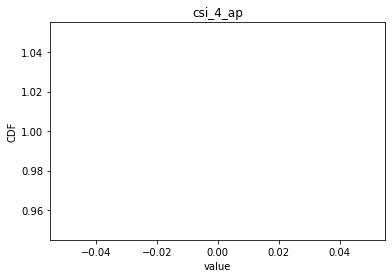

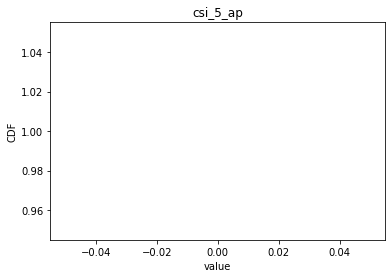

...

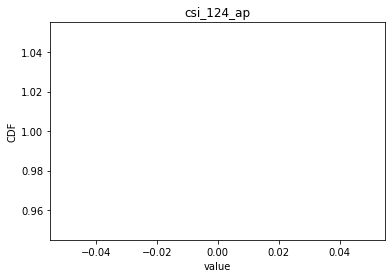

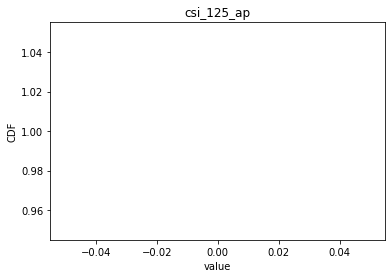

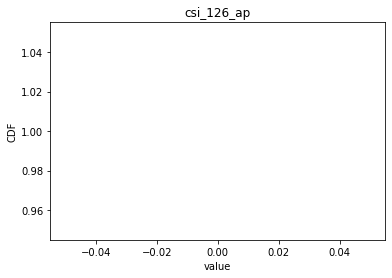

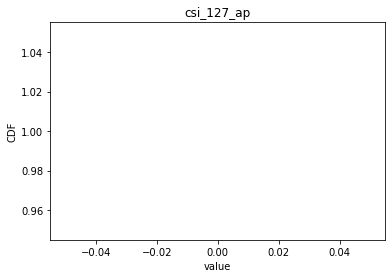

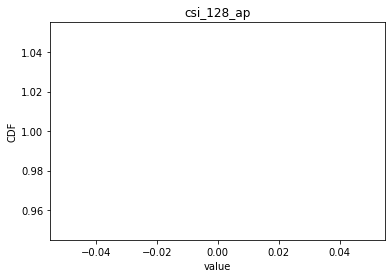

In [130]:
for i in range(128):
    cia = _df_join['csi_{}_ap'.format(i+1)]
    cdf = Cdf.from_seq(cia)
    cdf.plot()
    plt.title('csi_{}_ap'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('CDF')
    plt.show()

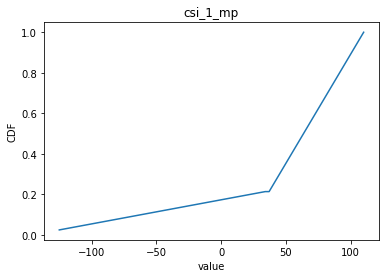

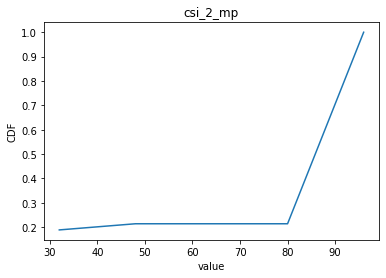

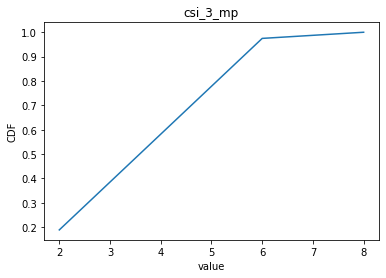

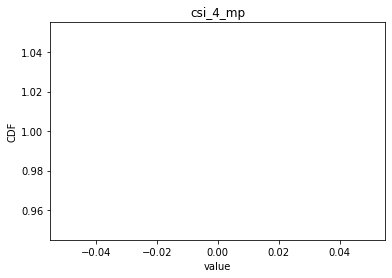

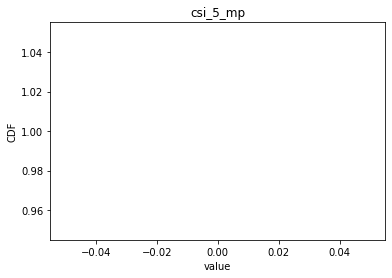

...

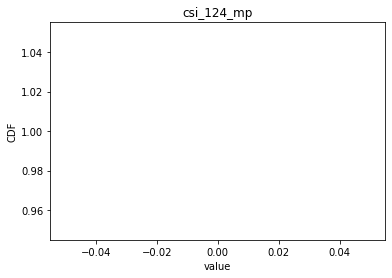

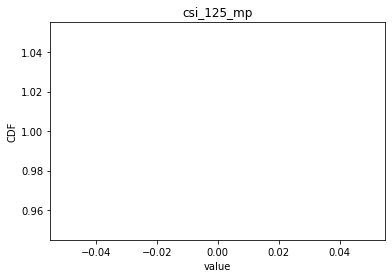

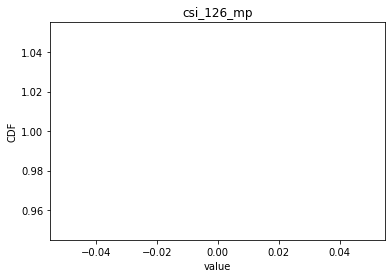

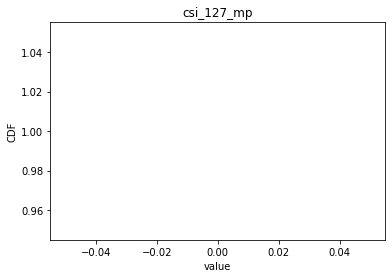

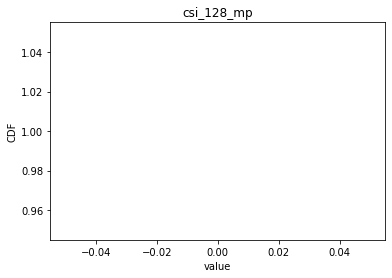

In [131]:
for i in range(128):
    cim = _df_join['csi_{}_mp'.format(i+1)]
    cdf = Cdf.from_seq(cim)
    cdf.plot()
    plt.title('csi_{}_mp'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('CDF')
    plt.show()

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

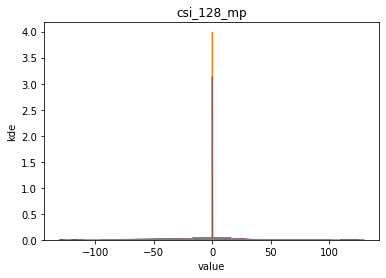

In [134]:
for i in range(128):
    cia = _df_join['csi_{}_ap'.format(i+1)]
    plt.xlabel('value')
    plt.ylabel('kde')
    sns.kdeplot(cia)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

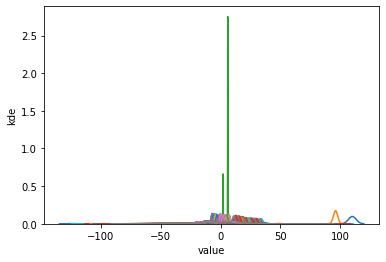

In [135]:
for i in range(128):
    cim = _df_join['csi_{}_mp'.format(i+1)]
    plt.xlabel('value')
    plt.ylabel('kde')
    sns.kdeplot(cim)

人数によって変わるか？

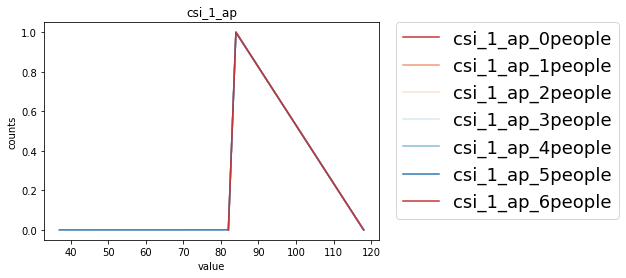

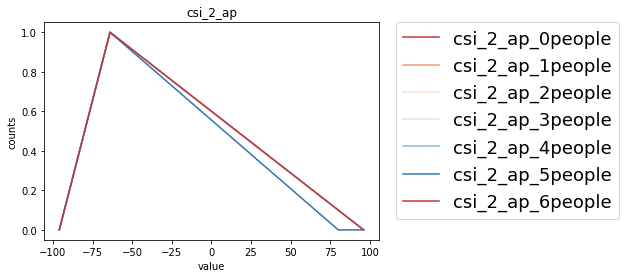

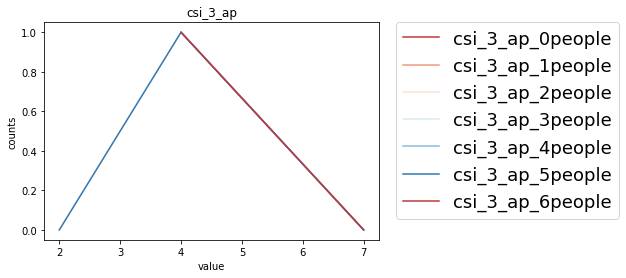

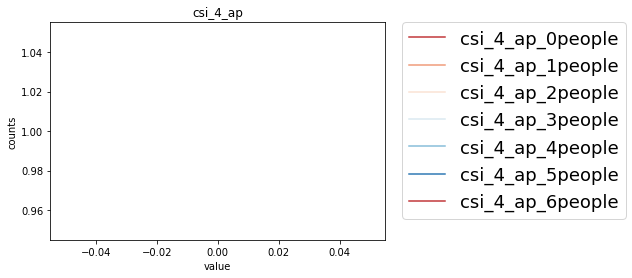

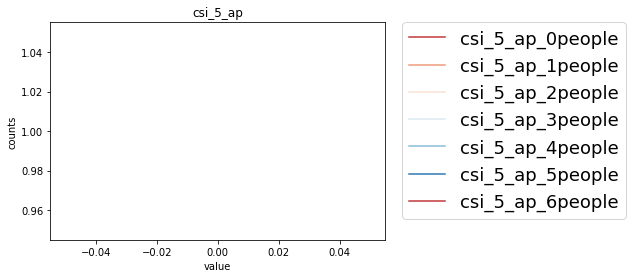

...

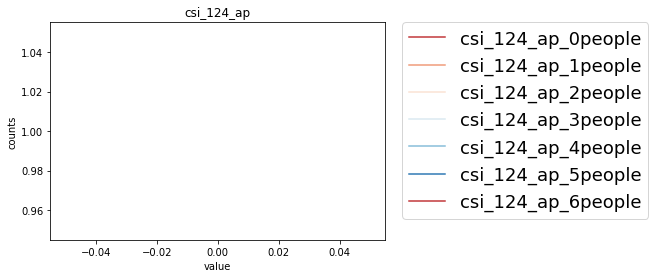

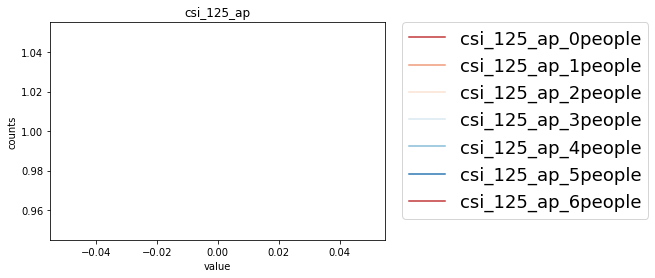

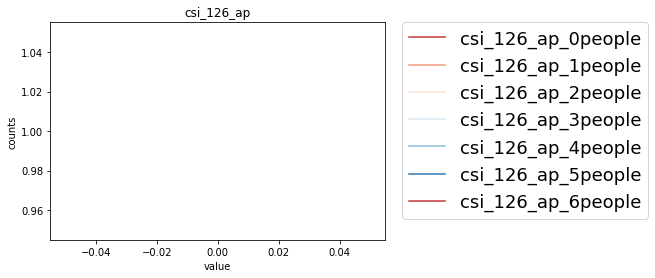

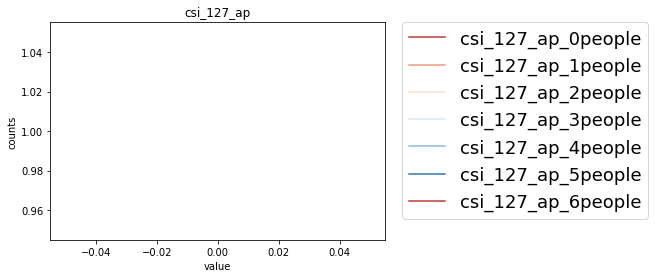

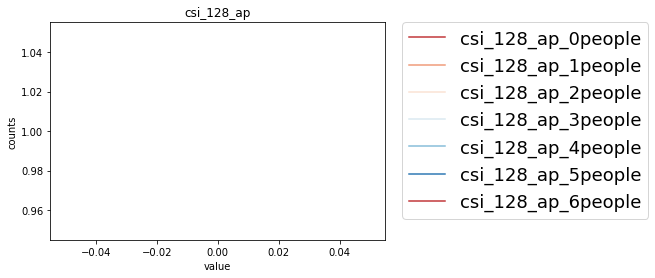

In [153]:
for i in range(128):
    sns.set_palette("RdBu")
    cia = _df_join['csi_{}_ap'.format(i+1)]
    for j in range(7):
        ciaj = _df_join[_df_join['label'] == j]['csi_{}_ap'.format(i+1)]
        pmf_ciaj = Pmf.from_seq(ciaj, normalize=True)
        pmf_ciaj.plot(label='csi_{}_ap_{}people'.format(i+1,j))
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18)
    plt.title('csi_{}_ap'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.show()

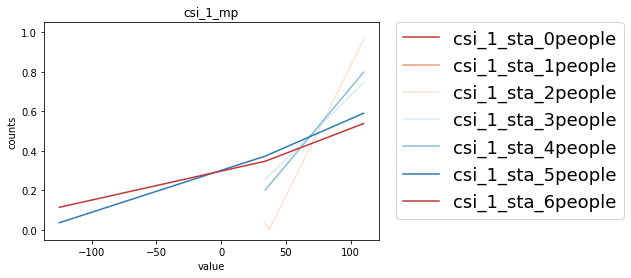

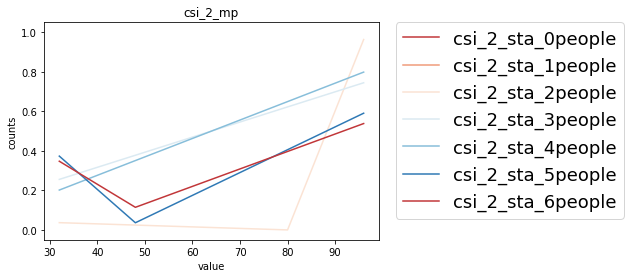

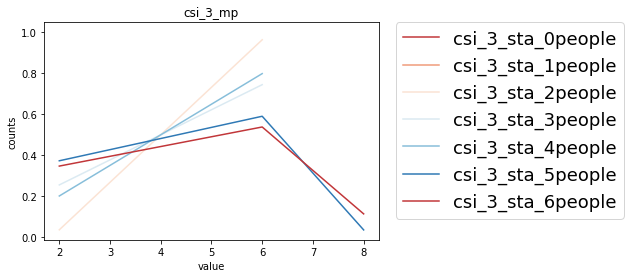

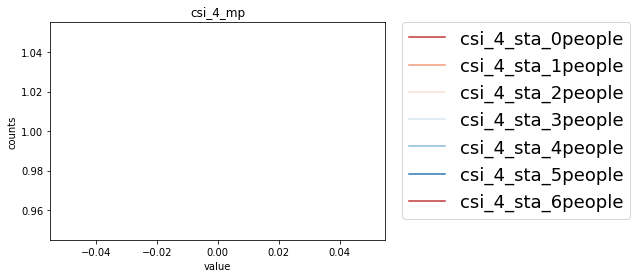

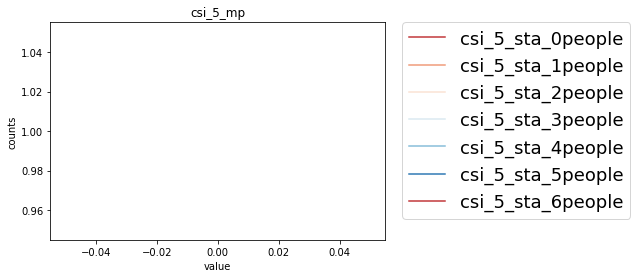

...

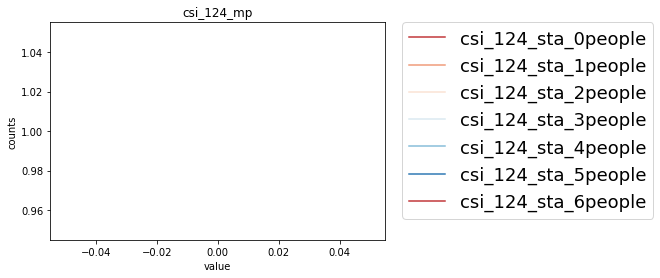

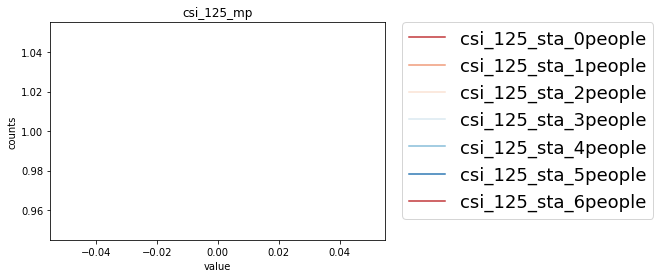

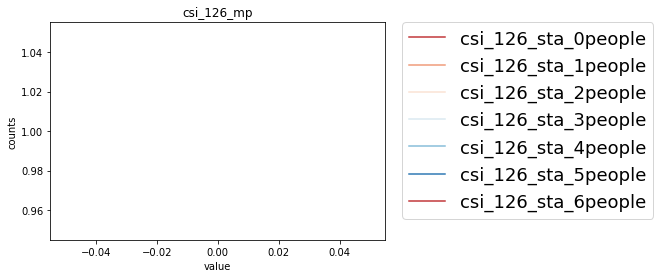

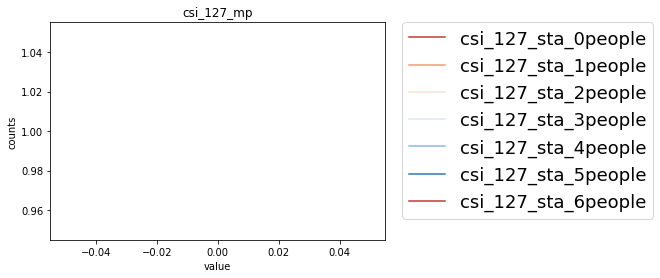

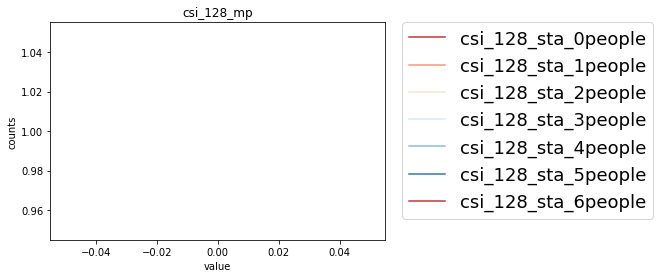

In [152]:
sns.set_palette("RdBu")
for i in range(128):
    cim = _df_join['csi_{}_mp'.format(i+1)]
    for j in range(7):
        cimj = _df_join[_df_join['label'] == j]['csi_{}_mp'.format(i+1)]
        pmf_cimj = Pmf.from_seq(cimj, normalize=True)
        pmf_cimj.plot(label='csi_{}_sta_{}people'.format(i+1,j))
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18)

    plt.title('csi_{}_mp'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.show()

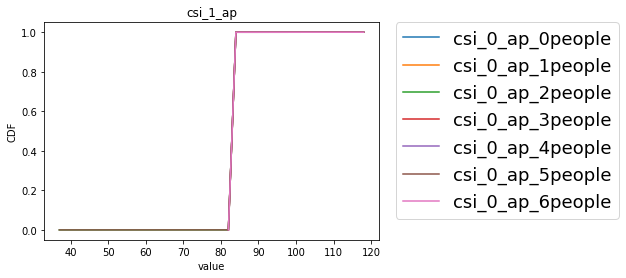

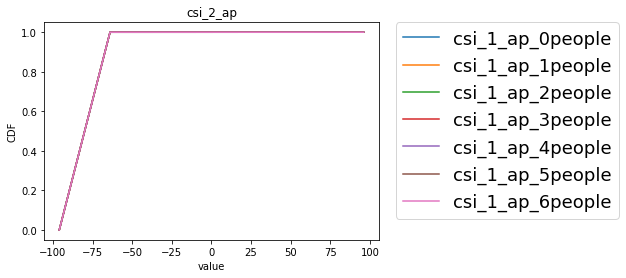

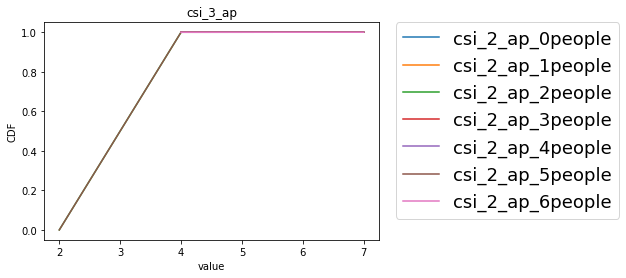

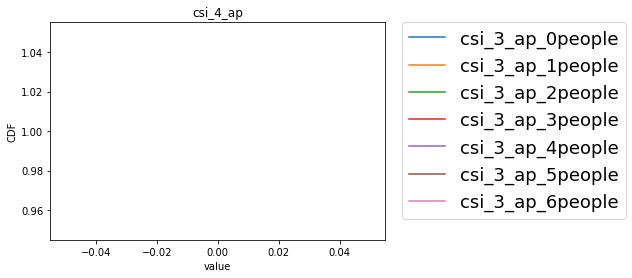

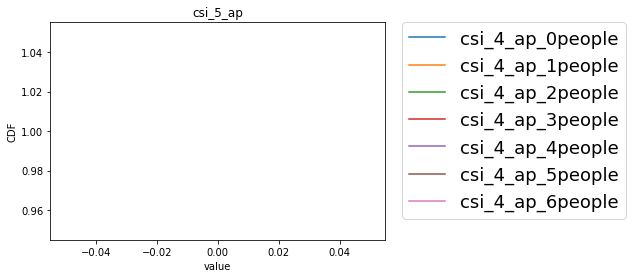

...

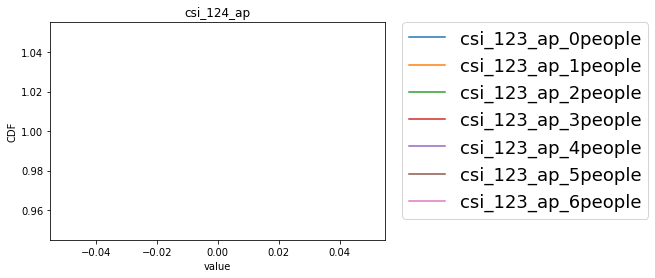

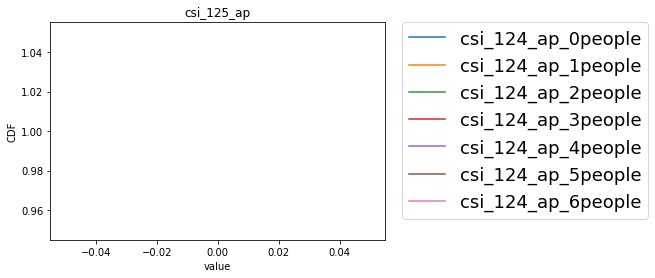

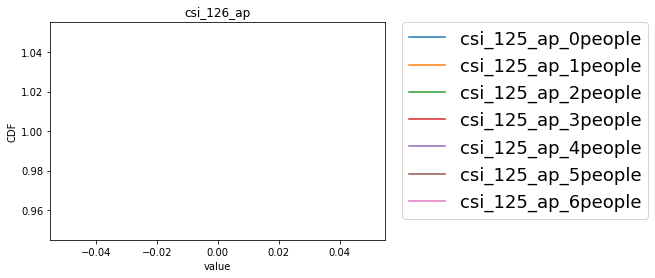

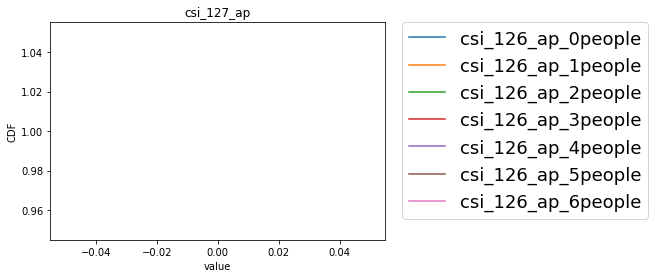

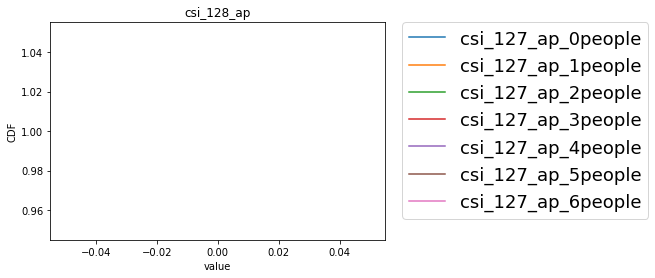

In [148]:
sns.set_palette("RdBu")
for i in range(128):
    cia = _df_join['csi_{}_ap'.format(i+1)]
    for j in range(7):
        ciaj = _df_join[_df_join['label'] == j]['csi_{}_ap'.format(i+1)]
        cdf_ciaj = Cdf.from_seq(ciaj)
        cdf_ciaj.plot(label='csi_{}_ap_{}people'.format(i+1,j))
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18)

        
#    cdf = Cdf.from_seq(cia)
#    cdf.plot()
    plt.title('csi_{}_ap'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('CDF')
    plt.show()

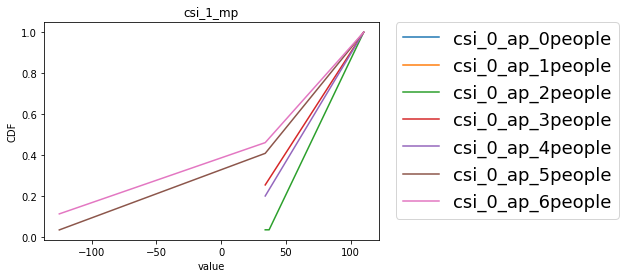

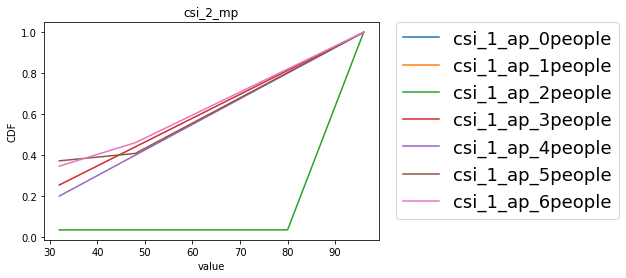

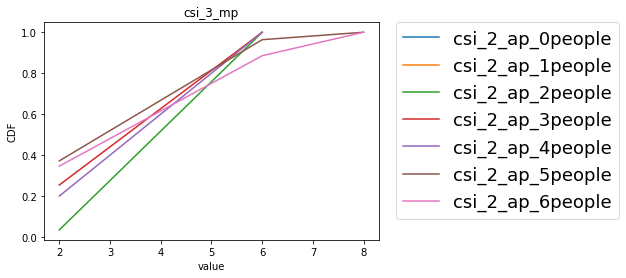

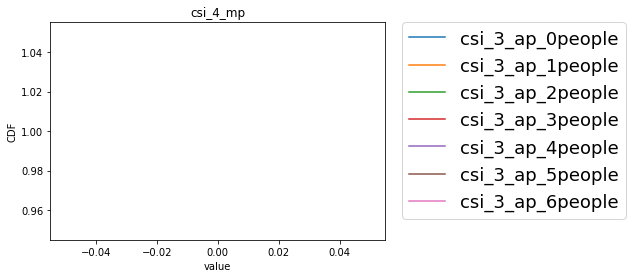

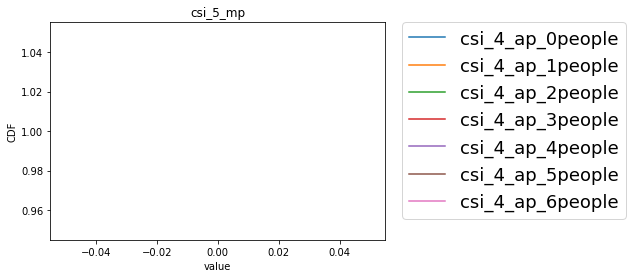

...

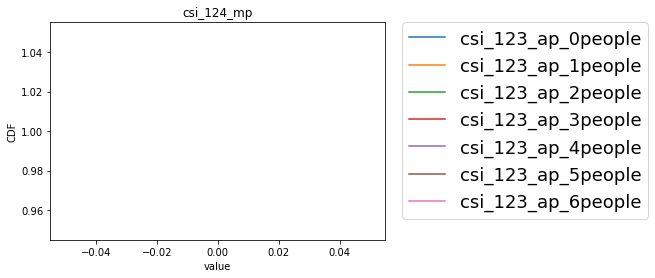

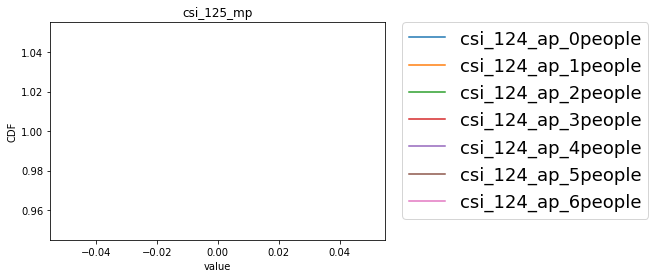

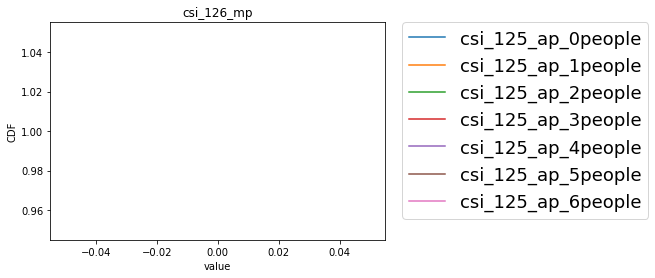

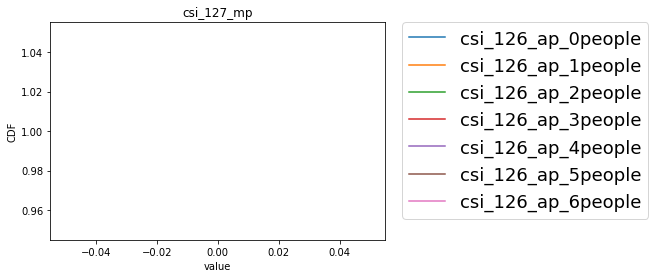

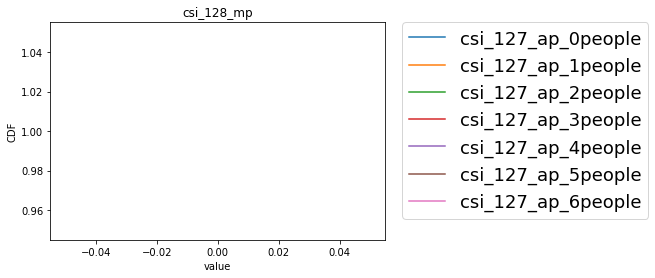

In [149]:
sns.set_palette("RdBu")
for i in range(128):
    cim = _df_join['csi_{}_mp'.format(i+1)]
    for j in range(7):
        cimj = _df_join[_df_join['label'] == j]['csi_{}_mp'.format(i+1)]
        cdf_cimj = Cdf.from_seq(cimj)
        cdf_cimj.plot(label='csi_{}_ap_{}people'.format(i+1,j))
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=18)

        
#    cdf = Cdf.from_seq(cia)
#    cdf.plot()
    plt.title('csi_{}_mp'.format(i+1))
    plt.xlabel('value')
    plt.ylabel('CDF')
    plt.show()

In [179]:
print(_df_ap.shape)
print(_df_mp.shape)
print(_df_join.shape)
print(_df_ap0127.shape)
print(_df_ap_04.shape)
print(_df_ap_56.shape)
print(_df_mp_04.shape)
print(_df_mp_56.shape)
print(_df_join_04.shape) 
print(_df_join_56.shape)

(4370, 130)
(4998, 130)
(4998, 258)
(899, 130)
(3105, 130)
(1265, 130)
(4009, 130)
(989, 130)
(4009, 258)
(989, 258)


## <font color="Orange"> filter</font>

 #### <font color="MediumTurquoise"> FFT</font>

https://algorithm.joho.info/programming/python/numpy-ifft-lowpass-denoise/
https://teratail.com/questions/237486

In [46]:
def _fft_and_filtering(_df, _cutoff_freq):
    _df_result = _df[['timestamp', 'label']]

    # set cut-off-frequency
    cut_off_frequency = _cutoff_freq
    
    _csi_columns = _df.columns[2:]
    
    for col in _csi_columns:
        _data = _df[col].values
        
        # set parameters for fft
        N = len(_data) # data length
        dt = 0.01 # sampling interval
        fc = cut_off_frequency # cut-off frequency
        t = np.arange(0, N*dt, dt) # time-axis
        freq = np.linspace(0, 1.0/dt, N) # frequency-axis

        # fft 
        # 高速フーリエ変換（周波数信号に変換）
        FFT = np.fft.fft(_data)
        # 正規化 + 交流成分2倍
        FFT = FFT/(N/2)
        FFT[0] = FFT[0]/2
        # 配列Fをコピー
        FFT_copy = FFT.copy()
        # ローパスフィル処理（カットオフ周波数を超える帯域の周波数信号を0にする）
        FFT_copy[(freq < 0)] = 0
        FFT_copy[(freq >cut_off_frequency)] = 0
        
        # inverse fft
        # 高速逆フーリエ変換（時間信号に戻す）
        IFFT = np.fft.ifft(FFT_copy)
        # 振幅を元のスケールに戻す
        IFFT = np.real(IFFT*N)

#        col_modified = '{}_modified'.format(col)
#        _df_result['{}_modified'.format(col)] = IFFT + np.mean(_data)
        _df_result['{}'.format(col)] = IFFT + np.mean(_data)
    
    return _df_result

In [148]:
_df_ap_modified_fft = _fft_and_filtering(_df_ap, 20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [48]:
#_df_mp_modified_fft = _fft_and_filtering(_df_mp, 20)

In [49]:
#_df_join_modified_fft = _fft_and_filtering(_df_join, 20)

In [50]:
#_df_ap_04_modified_fft = _fft_and_filtering(_df_ap_04, 20)

In [51]:
#_df_mp_04_modified_fft = _fft_and_filtering(_df_mp_04, 20)

In [52]:
#_df_join_04_modified_fft = _fft_and_filtering(_df_join_04, 20)

フーリエ転換を清家さんにもらった本で勉強するか。

 #### <font color="MediumTurquoise"> DWT</font>

https://qiita.com/boro1234/items/87472221ba7fd9a07c60
https://pywavelets.readthedocs.io/en/latest/ref/dwt-discrete-wavelet-transform.html

In [53]:
def maddest(d, axis=None):
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

def denoise(x, level, wavelet='db1'):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    sigma = (1/0.6745) * maddest(coeff[-level])

    uthresh = sigma * np.sqrt(2*np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])

    return pywt.waverec(coeff, wavelet, mode='per')

In [54]:
def _dwt_and_filtering(_df, _level):
    
    _df_result = _df[['timestamp', 'label']]
    
    _csi_columns = _df.columns[2:]
    
    for col in _csi_columns:
        _data = _df[col].values
        
        _data_result = denoise(_data, _level)
### _df_ap では _data -> _data_result で 1つ項目が増えるというおかしなことが起きてる。
# 原因究明しなきゃやけど、とりあえず [1:] をつけるという応急処置をする。
#        print(len(_data))
#        print(len(_data_result))
#        print(np.isnan(_data_result).any())
#        print(len(_data_result))
###        
#        _df_result['{}_modified'.format(col)] = _data_result
        _df_result['{}'.format(col)] = _data_result
    return _df_result

In [55]:
#_df_ap.head()

In [149]:
_df_ap_modified_dwt = _dwt_and_filtering(_df_ap[1:], _level=1)
#_df_mp_modified_dwt = _dwt_and_filtering(_df_mp, _level=1)
#_df_join_modified_dwt = _dwt_and_filtering(_df_join, _level=1)
#_df_ap_04_modified_dwt = _dwt_and_filtering(_df_ap_04, _level=1)
#_df_mp_04_modified_dwt = _dwt_and_filtering(_df_mp_04, _level=1)
#_df_join_04_modified_dwt = _dwt_and_filtering(_df_join_04[1:], _level=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [150]:
_df_ap_modified_fft_dwt = _dwt_and_filtering(_df_ap_modified_fft[1:], _level=1)
#_df_mp_modified_fft_dwt = _dwt_and_filtering(_df_mp_modified_fft, _level=1)
#_df_join_modified_fft_dwt = _dwt_and_filtering(_df_join_modified_fft, _level=1)
#_df_ap_04_modified_fft_dwt = _dwt_and_filtering(_df_ap_04_modified_fft, _level=1)
#_df_mp_04_modified_fft_dwt = _dwt_and_filtering(_df_mp_04_modified_fft, _level=1)
#_df_join_04_modified_fft_dwt = _dwt_and_filtering(_df_join_04_modified_fft[1:], _level=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


 #### <font color="MediumTurquoise"> ZCA Whitening</font>

In [58]:
class ZCAWhitening:
    def __init__(self, epsilon=1E-6):
        self.epsilon = epsilon
        self.mean = None
        self.zca = None

    def fit(self, x):
        self.mean = np.mean(x, axis=0)
        x_ = x - self.mean
        cov = np.dot(x_.T, x_) / x_.shape[0]
        E, D, _ = np.linalg.svd(cov)
        D = np.sqrt(D) + self.epsilon
        self.zca = np.dot(E, np.dot(np.diag(1.0 / D), E.T))
        return self

    def transform(self, x):
        x_ = x - self.mean
        return np.dot(x_, self.zca.T)

In [59]:
def _zca_whitening(_df):
    _df_col = _df.columns
    _data= _df.values
    _t_l = _data[:, :2]
    _data = _data[:, 2:]
    
    _img_result = []
    for i in range(_data.shape[0]):
        img = _data[i]
        img = img.astype(np.float64)
        img_zcaw = img.reshape(img.shape[0], -1)
        zcaw = ZCAWhitening().fit(img_zcaw)
        data_zcaw = zcaw.transform(img_zcaw).reshape(img.shape)
        data_zcaw = data_zcaw.tolist()
        _img_result.append(data_zcaw)
        
    _img_result = np.array(_img_result)
    _results = np.append(_t_l, _img_result, axis=1)
    _df_results = pd.DataFrame(_results, columns = _df_col)
    
    return _df_results

 #### <font color="MediumTurquoise"> PCA Whitening</font>

In [60]:
class PCAWhitening:
    def __init__(self, epsilon=1E-6):
        self.epsilon = epsilon
        self.mean = None
        self.eigenvalue = None
        self.eigenvector = None
        self.pca = None

    def fit(self, x):
        self.mean = np.mean(x, axis=0)
        x_ = x - self.mean
        cov = np.dot(x_.T, x_) / x_.shape[0]
        E, D, _ = np.linalg.svd(cov)
        D = np.sqrt(D) + self.epsilon
        self.eigenvalue = D
        self.eigenvector = E
        self.pca = np.dot(np.diag(1. / D), E.T)
        return self

    def transform(self, x):
        x_ = x - self.mean
        return np.dot(x_, self.pca.T)

##関数化する
# x_pcaw = d.reshape(d.shape[0], -1)
# pcaw = PCAWhitening().fit(x_pcaw)
# x_pcaw = pcaw.transform(x_pcaw).reshape(d.shape)

 #### <font color="MediumTurquoise">確認</font>

In [61]:
#_df_ap_modified_fft_dwt.head()

In [62]:
#_df_mp_modified_fft_dwt.head()

In [63]:
#_df_join_modified_fft_dwt.head()

In [64]:
#_df_ap_04_modified_fft_dwt.head()

----------------------------------

## <font color="Orange">  models</font>

In [126]:
def model_lgb(_X_train, _X_test, _y_train):
    model = lgb.LGBMClassifier(n_jobs=-1, n_estimators=500, class_weight='balanced', random_state=0)
    
    model.fit(_X_train, _y_train)
    
    _y_test_pred = model.predict(_X_test)
    
#    ax = lgb.plot_importance(model, max_num_features=40, figsize=(15,15))
    ax = lgb.plot_importance(model, max_num_features=40, figsize=(15,15))

    plt.show()
    
    _y_test_pred_proba = pd.DataFrame(columns=['proba_0', 'proba_1', 'proba_2', 'proba_3', 'proba_4', 'proba_5', 'proba_6'])
    _y_test_pred_proba_0 =  model.predict_proba(_X_test)[:,0]
    _y_test_pred_proba_1 =  model.predict_proba(_X_test)[:,1]
#    _y_test_pred_proba_2 =  model.predict_proba(_X_test)[:,2]
#    _y_test_pred_proba_3 =  model.predict_proba(_X_test)[:,3]
#    _y_test_pred_proba_4 =  model.predict_proba(_X_test)[:,4]
#    _y_test_pred_proba_5 =  model.predict_proba(_X_test)[:,5]
#    _y_test_pred_proba_6 =  model.predict_proba(_X_test)[:,6]
    _y_test_pred_proba['proba_0'] = _y_test_pred_proba_0
    _y_test_pred_proba['proba_1'] = _y_test_pred_proba_1
#    _y_test_pred_proba['proba_2'] = _y_test_pred_proba_2
#    _y_test_pred_proba['proba_3'] = _y_test_pred_proba_3
#    _y_test_pred_proba['proba_4'] = _y_test_pred_proba_4
#    _y_test_pred_proba['proba_5'] = _y_test_pred_proba_5
#    _y_test_pred_proba['proba_6'] = _y_test_pred_proba_6
    
    _y_test_pred_proba = _y_test_pred_proba.values
     
    return _y_test_pred, _y_test_pred_proba

## <font color="Orange"> train</font>

In [92]:
def vc(_df):
    vc_label = _df['label'].value_counts()
    print(vc_label)
    print('\n')

In [93]:
vc(_df_ap)

2    119333
6    106406
4     97437
3     87524
1     82036
5     75467
0     61900
Name: label, dtype: int64




In [94]:
vc(_df_mp)

2    137073
4    132728
3    111884
6     84306
1     76462
0     45183
5     39234
Name: label, dtype: int64




In [95]:
vc(_df_join)

2    119333
6    106406
4     97437
3     87524
5     75467
1     68861
0     35404
Name: label, dtype: int64




In [127]:
def check_accuracy(_df):

    _X = _df.drop(['timestamp','label'], axis=1)
    _y = _df['label']
#     _y = _df['major_label']
    
#     max_value, min_value = max_min_check(_df)
#     _X =  (_X - min_value) / (max_value - min_value)
    
    _X_train, _X_test, _y_train,  _y_test = train_test_split(_X, _y, test_size=0.2, random_state=0)
    
#    _prediction_result = pd.DataFrame(columns=['model', 'data_type', 'nums_test', 'nums_correct', 'nums_ones', 'nums_twos', 'nums_threes', 'acc_vszero', 'confusion_matrix'])
    
    print('start!')
#     _y_test_pred, _y_test_pred_proba = model_cnn(_X_train, _X_test, _y_train)
#     _y_test_pred, _y_test_pred_proba = model_cnn_major(_X_train, _X_test, _y_train)
#     _y_test_pred, _y_test_pred_proba = model_resnet_major(_X_train, _X_test, _y_train)

#     _y_test_pred, _y_test_pred_proba = model_lgb_major(_X_train, _X_test, _y_train)
    _y_test_pred, _y_test_pred_proba = model_lgb(_X_train, _X_test, _y_train)
#     _y_test_pred, _y_test_pred_proba = model_rf_major(_X_train, _X_test, _y_train)

    _y_test = _y_test.values

    nums_test = len(_y_test)
    
    #counts
    _y_diff = np.abs(_y_test - _y_test_pred)
    
    nums_correct = np.count_nonzero(_y_diff == 0)
    nums_ones = np.count_nonzero(_y_diff == 1)
    nums_twos = np.count_nonzero(_y_diff == 2)
    nums_threes = np.count_nonzero(_y_diff == 3)
    nums_fours = np.count_nonzero(_y_diff == 4)
    nums_fives = np.count_nonzero(_y_diff == 5)
    nums_sixs = np.count_nonzero(_y_diff == 6)
    
#     #zero vs non-zero
    _y_test_vszero = np.where(_y_test < 1, 0, 1)
    _y_test_pred_vszero = np.where(_y_test_pred < 1, 0, 1)
 
    acc= accuracy_score(_y_test_vszero, _y_test_pred_vszero)
    
    print('■accuracy')
    print('acc : {}'.format(round((nums_correct/nums_test), 4)))
    print('\n')
    
    #counts
    print('■counts [all : {}]'.format(nums_test))
    print('corret : {} [{}%]'.format(nums_correct, round((nums_correct/nums_test)*100)))
    print('non-correct +1 or -1 : {} [{}%]'.format(nums_ones, round((nums_ones/nums_test)*100)))
    print('non-correct +2 or -2 : {} [{}%]'.format(nums_twos, round((nums_twos/nums_test)*100)))
    print('non-correct +3 or -3 : {} [{}%]'.format(nums_threes, round((nums_threes/nums_test)*100)))
    print('non-correct +4 or -4 : {} [{}%]'.format(nums_fours, round((nums_fours/nums_test)*100)))
    print('non-correct +5 or -5 : {} [{}%]'.format(nums_fives, round((nums_fives/nums_test)*100)))
    print('non-correct +6 or -6 : {} [{}%]'.format(nums_sixs, round((nums_sixs/nums_test)*100)))

    ##### multi-class logloss
    
#    logloss = log_loss(_y_test, _y_test_pred_proba)
#    print('■multi-class logloss')
#    print('multi-class logloss:{}'.format(round(logloss,4)))
#    print('\n')
    
    ##### mean-f1, macro-f1, micro-f1
    
#    display(_y_test)
#    display(_y_test_pred)
    
#    _y_test = pd.DataFrame(_y_test)
#    _y_test_pred = pd.DataFrame(_y_test_pred)
    _y_test = pd.get_dummies(_y_test).to_numpy()
    _y_test_pred = pd.get_dummies(_y_test_pred).to_numpy()
        
#    mean_f1 = f1_score(_y_test, _y_test_pred, average='samples')
    macro_f1 = f1_score(_y_test, _y_test_pred, average='macro') 
#    micro_f1 = f1_score(_y_test, _y_test_pred, average='micro')

#    print('■mean_f1')
#    print('mean_f1: {}'.format(round(mean_f1,4)))
    print('■macro_f1')
    print('macro_f1: {}'.format(round(macro_f1,4)))
#    print('■micro_f1')
#    print('micro_f1: {}'.format(round(micro_f1,4)))
    print('\n')
    
    ##### zero vs non-zero
    print('■zero vs non-zero') 
    print('■accuracy')
    print('accuracy : {}'.format(round(accuracy_score(_y_test_vszero, _y_test_pred_vszero),4)))
    print('\n')
    
    ##### precision 
    precision = precision_score(_y_test_vszero, _y_test_pred_vszero)
    print('■precision')
    print('precision : {}'.format(round(precision,4)))
    print('\n')
    
    ##### recall
    recall = recall_score(_y_test_vszero, _y_test_pred_vszero)
    print('■recall')
    print('recall : {}'.format(round(recall,4)))
    print('\n')
    
    ##### F1
    f1 = f1_score(_y_test_vszero, _y_test_pred_vszero)
    print('■f1')
    print('f1 : {}'.format(round(f1,4)))
    print('\n')
    
    return

In [128]:
def main(_df):
    check_accuracy(_df)
    
#     evaluation_output(_prediction_result)
    
#     return _prediction_result
    return 0

start!


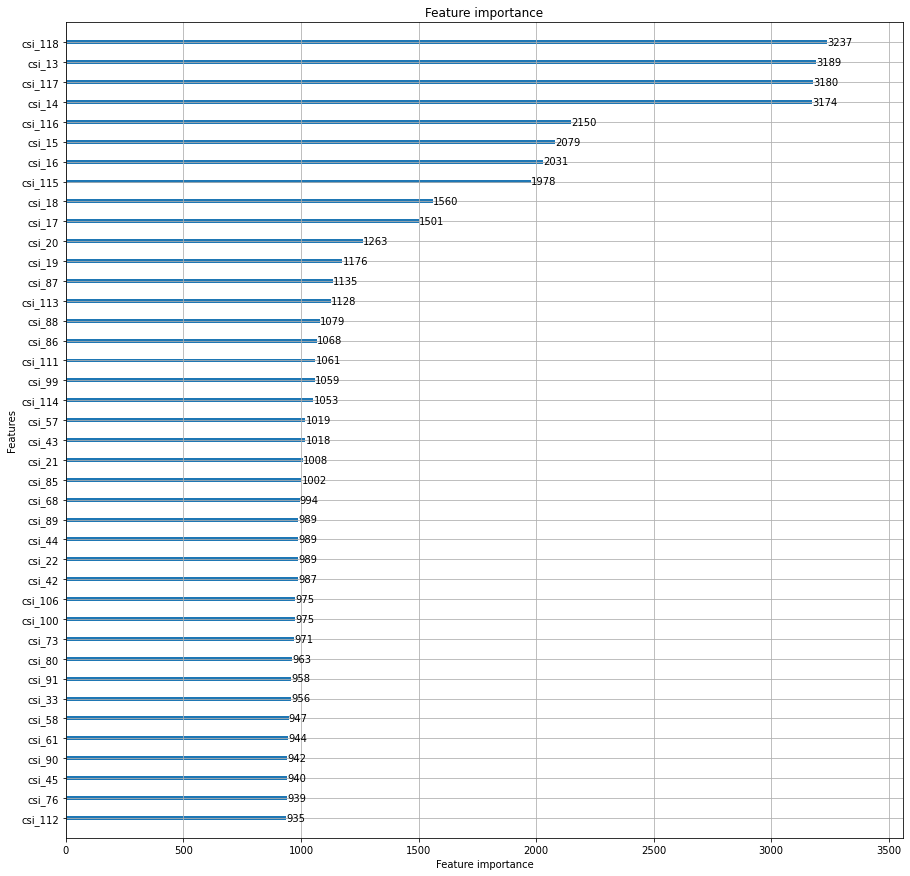

■accuracy
acc : 0.6889


■counts [all : 126021]
corret : 86813 [69%]
non-correct +1 or -1 : 16099 [13%]
non-correct +2 or -2 : 11300 [9%]
non-correct +3 or -3 : 5687 [5%]
non-correct +4 or -4 : 3382 [3%]
non-correct +5 or -5 : 1573 [1%]
non-correct +6 or -6 : 1167 [1%]
■macro_f1
macro_f1: 0.6904


■zero vs non-zero
■accuracy
accuracy : 0.9329


■precision
precision : 0.9854


■recall
recall : 0.9396


■f1
f1 : 0.962




In [133]:
_prediction_result = main(_df_ap)

start!


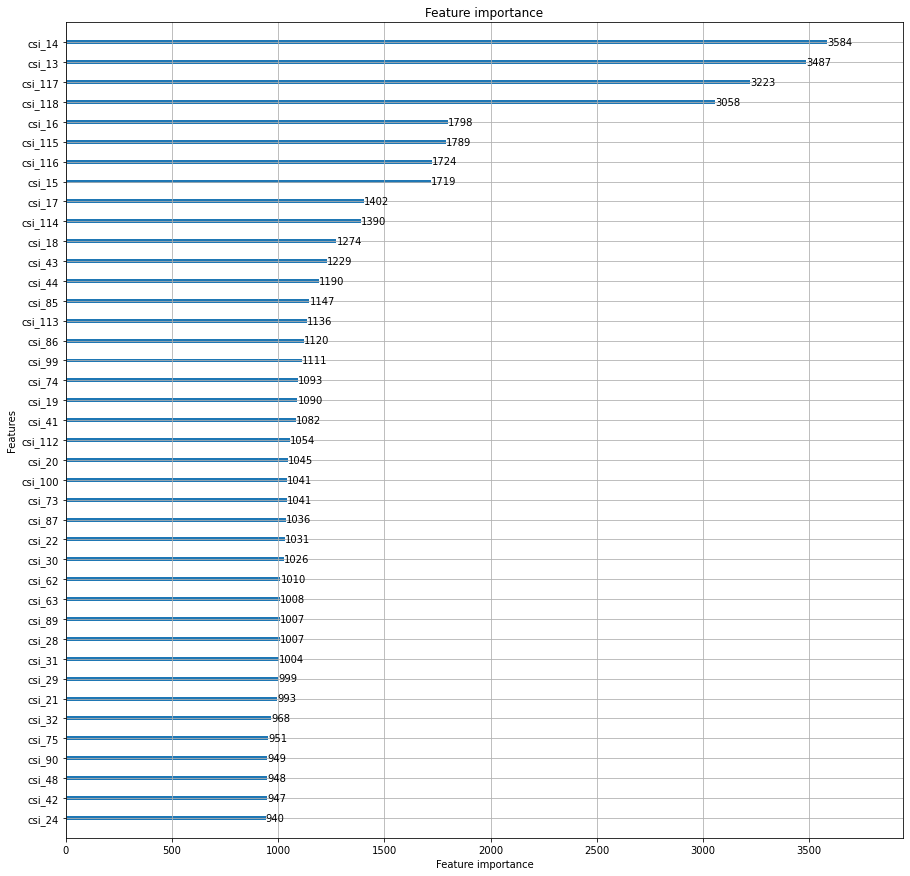

■accuracy
acc : 0.661


■counts [all : 125374]
corret : 82870 [66%]
non-correct +1 or -1 : 18802 [15%]
non-correct +2 or -2 : 12405 [10%]
non-correct +3 or -3 : 5637 [4%]
non-correct +4 or -4 : 2867 [2%]
non-correct +5 or -5 : 1741 [1%]
non-correct +6 or -6 : 1052 [1%]
■macro_f1
macro_f1: 0.6597


■zero vs non-zero
■accuracy
accuracy : 0.9403


■precision
precision : 0.9938


■recall
recall : 0.9415


■f1
f1 : 0.967




In [135]:
_prediction_result = main(_df_mp)

start!


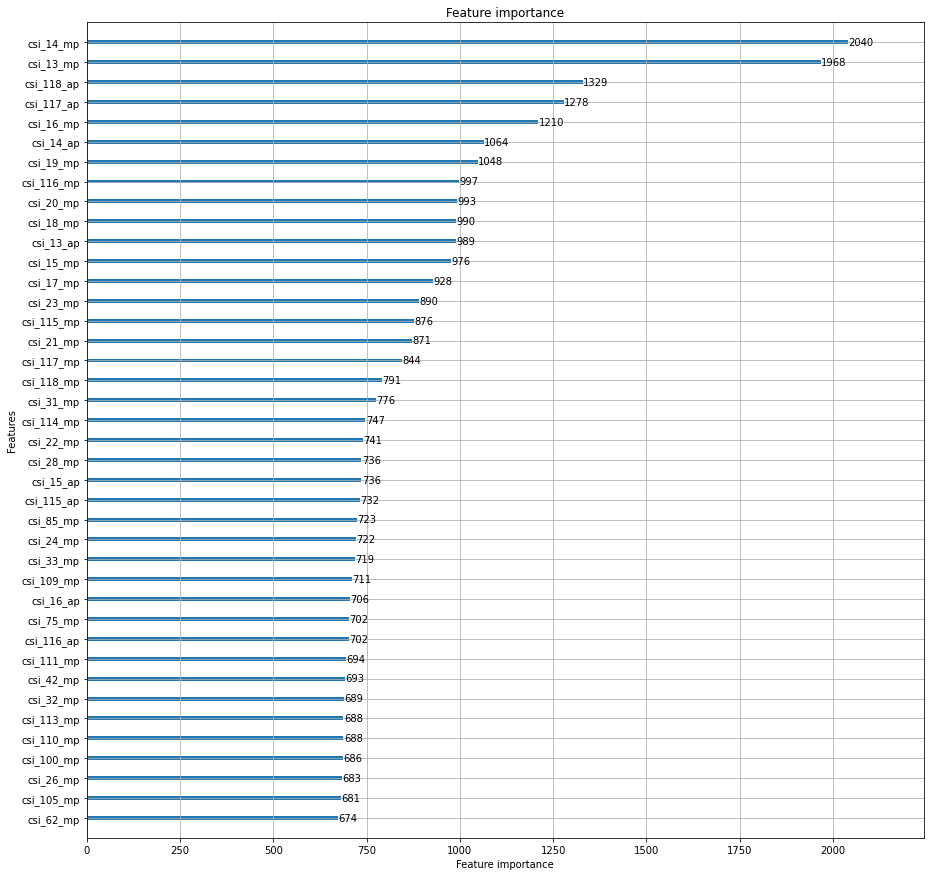

■accuracy
acc : 0.973


■counts [all : 118087]
corret : 114897 [97%]
non-correct +1 or -1 : 2480 [2%]
non-correct +2 or -2 : 514 [0%]
non-correct +3 or -3 : 156 [0%]
non-correct +4 or -4 : 40 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9748


■zero vs non-zero
■accuracy
accuracy : 1.0


■precision
precision : 1.0


■recall
recall : 1.0


■f1
f1 : 1.0




In [131]:
_prediction_result = main(_df_join)

In [137]:
_df_ap_modified_fft = _fft_and_filtering(_df_ap[1:], 20)
_df_ap_modified_dwt = _dwt_and_filtering(_df_ap[1:], _level=1)
_df_ap_modified_fft_dwt = _dwt_and_filtering(_df_ap_modified_fft, _level=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


start!


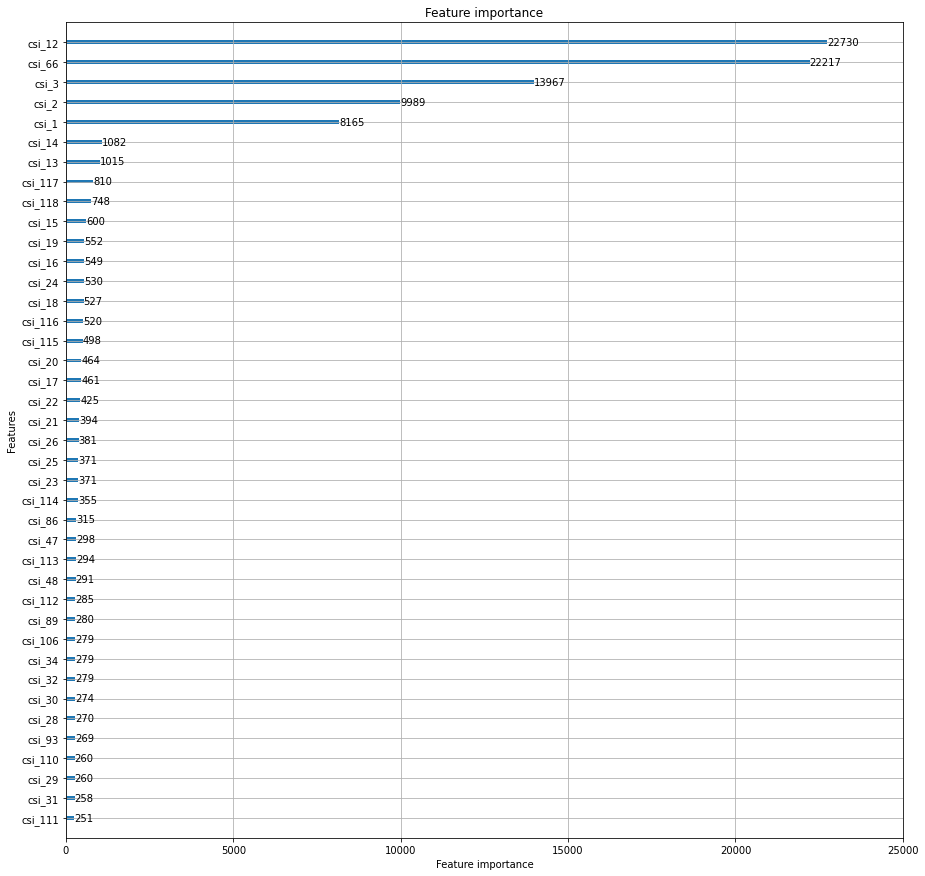

■accuracy
acc : 0.998


■counts [all : 126021]
corret : 125772 [100%]
non-correct +1 or -1 : 124 [0%]
non-correct +2 or -2 : 82 [0%]
non-correct +3 or -3 : 34 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 4 [0%]
non-correct +6 or -6 : 5 [0%]
■macro_f1
macro_f1: 0.9981


■zero vs non-zero
■accuracy
accuracy : 0.9999


■precision
precision : 1.0


■recall
recall : 0.9999


■f1
f1 : 0.9999




In [138]:
_prediction_result = main(_df_ap_modified_fft)

start!


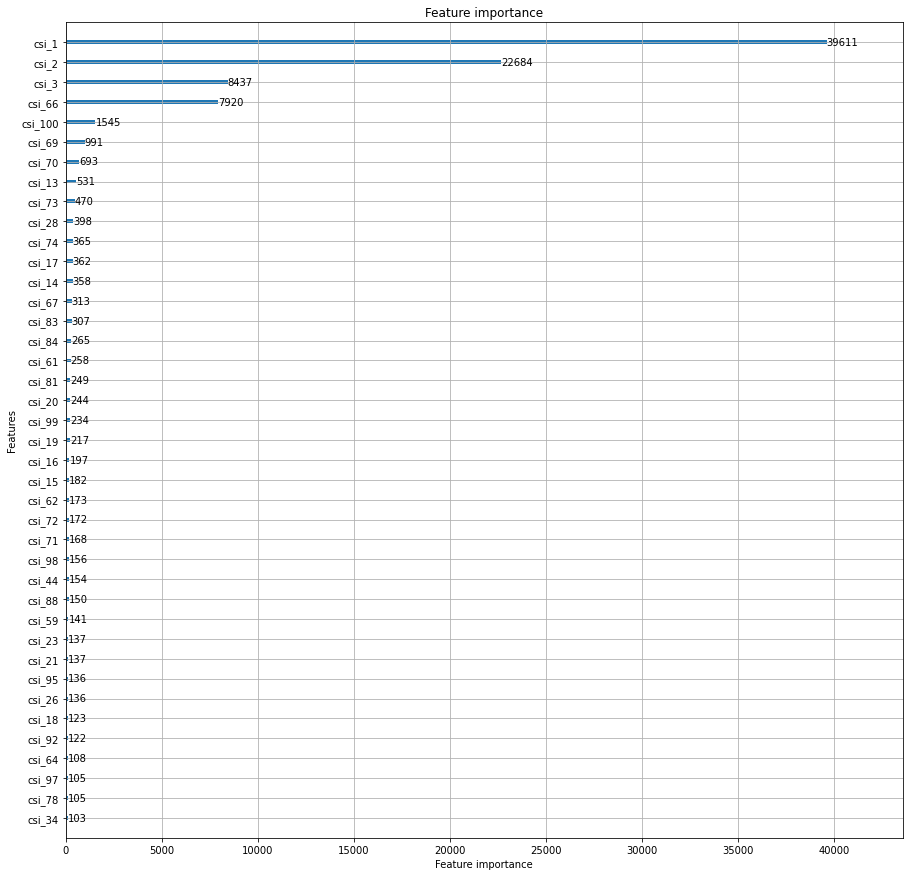

■accuracy
acc : 0.784


■counts [all : 126021]
corret : 98802 [78%]
non-correct +1 or -1 : 17009 [13%]
non-correct +2 or -2 : 4487 [4%]
non-correct +3 or -3 : 1851 [1%]
non-correct +4 or -4 : 2907 [2%]
non-correct +5 or -5 : 965 [1%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.7788


■zero vs non-zero
■accuracy
accuracy : 0.9679


■precision
precision : 0.9892


■recall
recall : 0.975


■f1
f1 : 0.9821




In [139]:
_prediction_result = main(_df_ap_modified_dwt)

start!


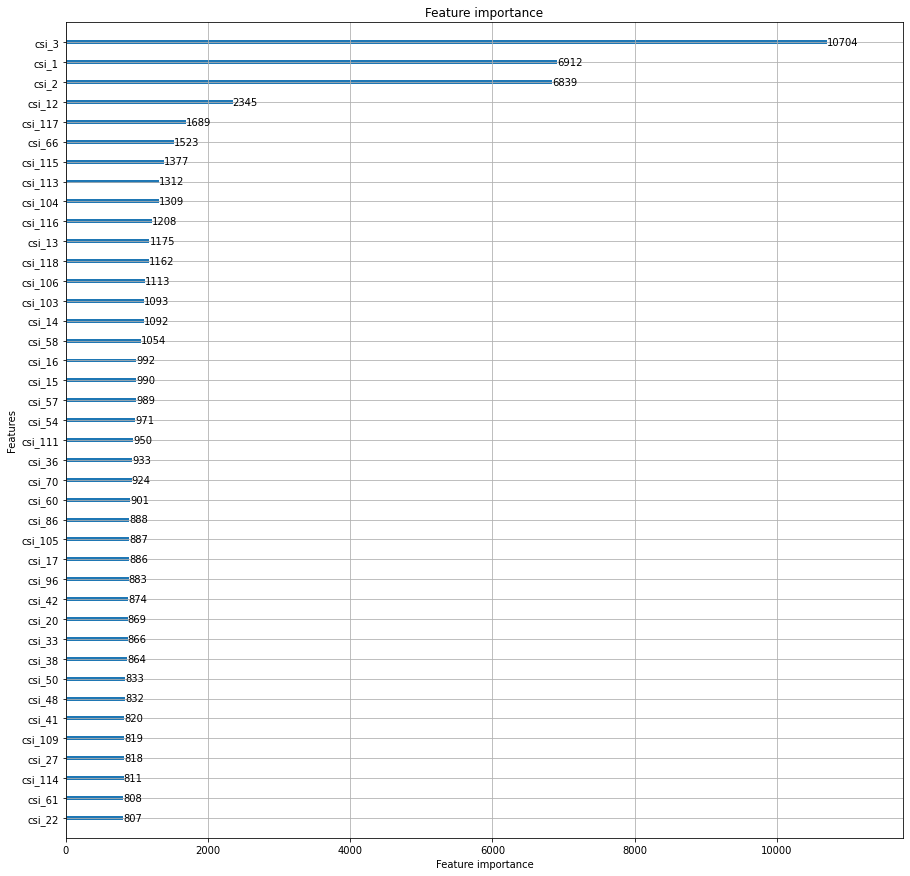

■accuracy
acc : 0.994


■counts [all : 126021]
corret : 125262 [99%]
non-correct +1 or -1 : 488 [0%]
non-correct +2 or -2 : 208 [0%]
non-correct +3 or -3 : 63 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9942


■zero vs non-zero
■accuracy
accuracy : 0.9991


■precision
precision : 1.0


■recall
recall : 0.999


■f1
f1 : 0.9995




In [140]:
_prediction_result = main(_df_ap_modified_fft_dwt)

In [141]:
_df_mp_modified_fft = _fft_and_filtering(_df_mp, 20)
_df_mp_modified_dwt = _dwt_and_filtering(_df_mp, _level=1)
_df_mp_modified_fft_dwt = _dwt_and_filtering(_df_mp_modified_fft, _level=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


start!


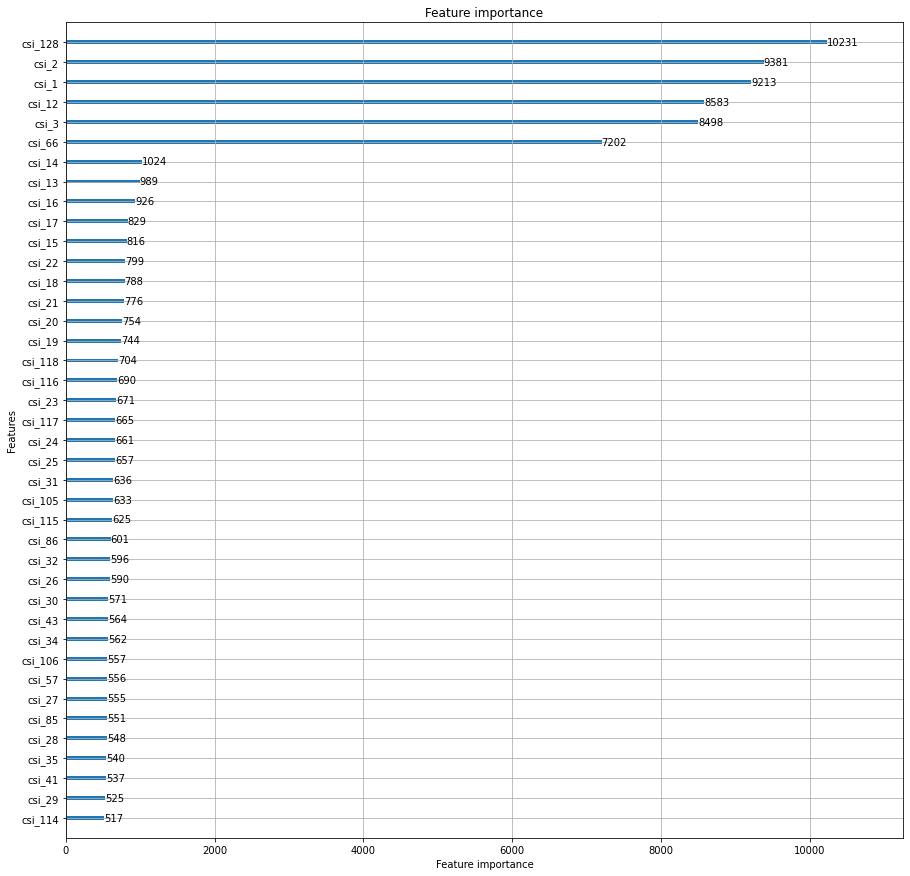

■accuracy
acc : 0.9971


■counts [all : 125374]
corret : 125011 [100%]
non-correct +1 or -1 : 215 [0%]
non-correct +2 or -2 : 100 [0%]
non-correct +3 or -3 : 48 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.997


■zero vs non-zero
■accuracy
accuracy : 0.9994


■precision
precision : 0.9998


■recall
recall : 0.9996


■f1
f1 : 0.9997




In [142]:
_prediction_result = main(_df_mp_modified_fft)

start!


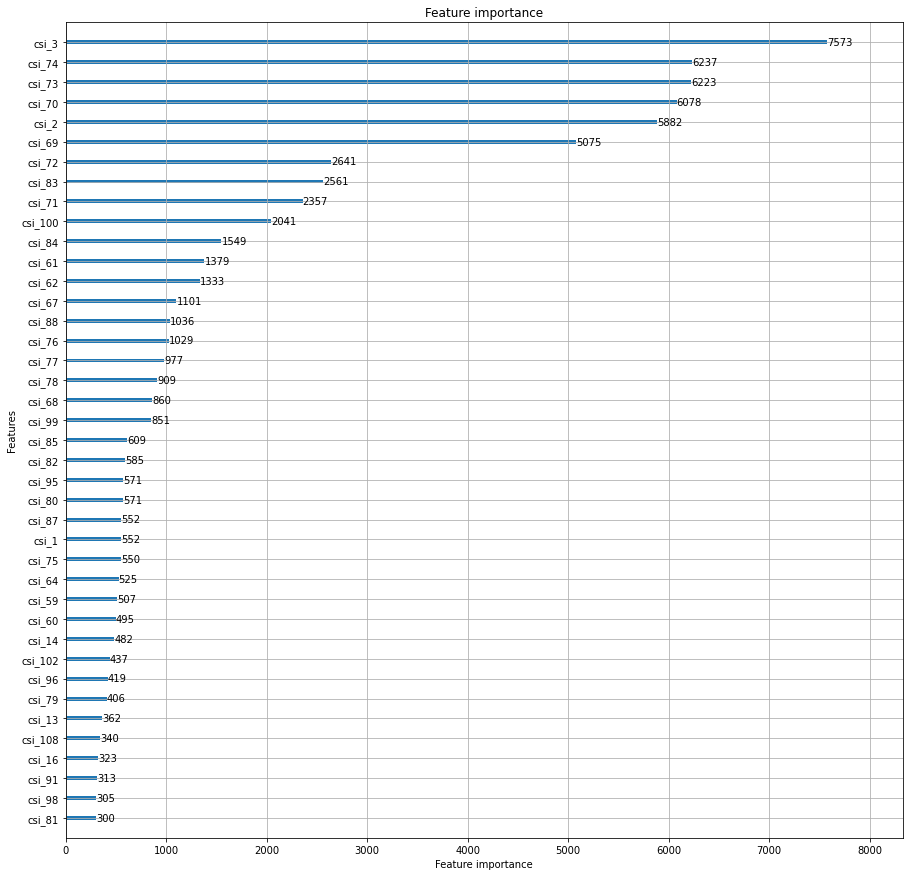

■accuracy
acc : 0.2321


■counts [all : 125374]
corret : 29105 [23%]
non-correct +1 or -1 : 18936 [15%]
non-correct +2 or -2 : 26329 [21%]
non-correct +3 or -3 : 18618 [15%]
non-correct +4 or -4 : 19414 [15%]
non-correct +5 or -5 : 3198 [3%]
non-correct +6 or -6 : 9774 [8%]
■macro_f1
macro_f1: 0.2642


■zero vs non-zero
■accuracy
accuracy : 0.4013


■precision
precision : 0.9706


■recall
recall : 0.3667


■f1
f1 : 0.5323




In [143]:
_prediction_result = main(_df_mp_modified_dwt)

start!


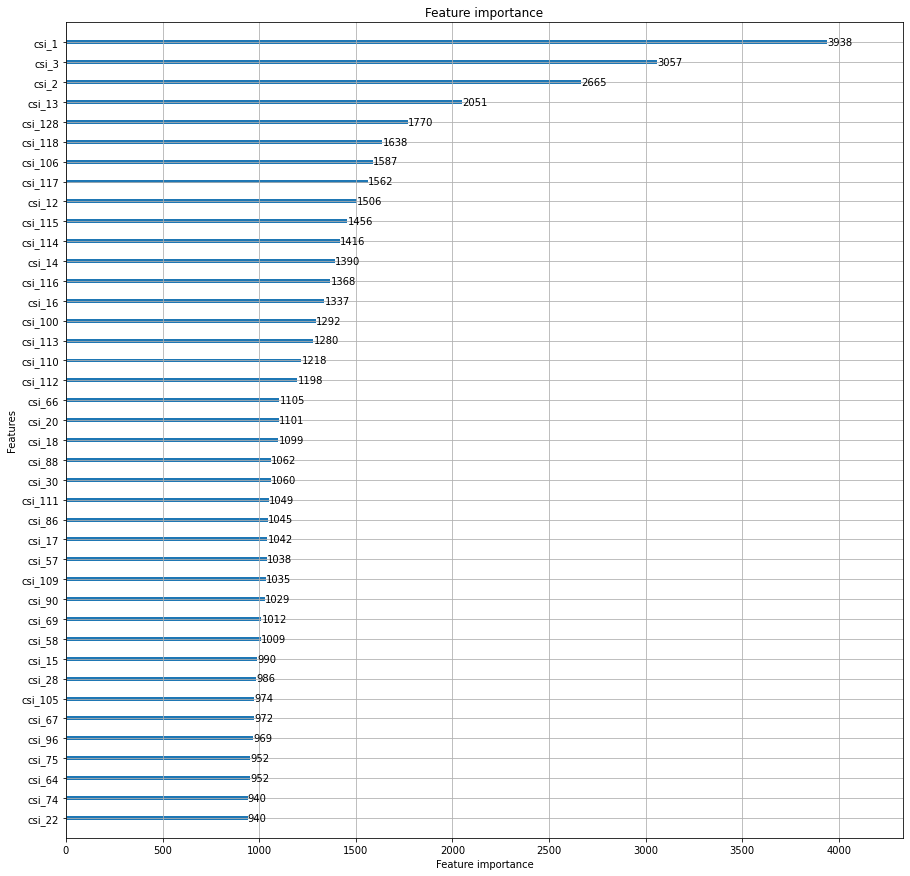

■accuracy
acc : 0.9876


■counts [all : 125374]
corret : 123815 [99%]
non-correct +1 or -1 : 762 [1%]
non-correct +2 or -2 : 740 [1%]
non-correct +3 or -3 : 57 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9867


■zero vs non-zero
■accuracy
accuracy : 0.9965


■precision
precision : 0.9999


■recall
recall : 0.9963


■f1
f1 : 0.9981




In [144]:
_prediction_result = main(_df_mp_modified_fft_dwt)

In [87]:
_df_join_modified_fft = _fft_and_filtering(_df_join, 20)
_df_join_modified_dwt = _dwt_and_filtering(_df_join, _level=1)
_df_join_modified_fft_dwt = _dwt_and_filtering(_df_join_modified_fft, _level=1)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


start!


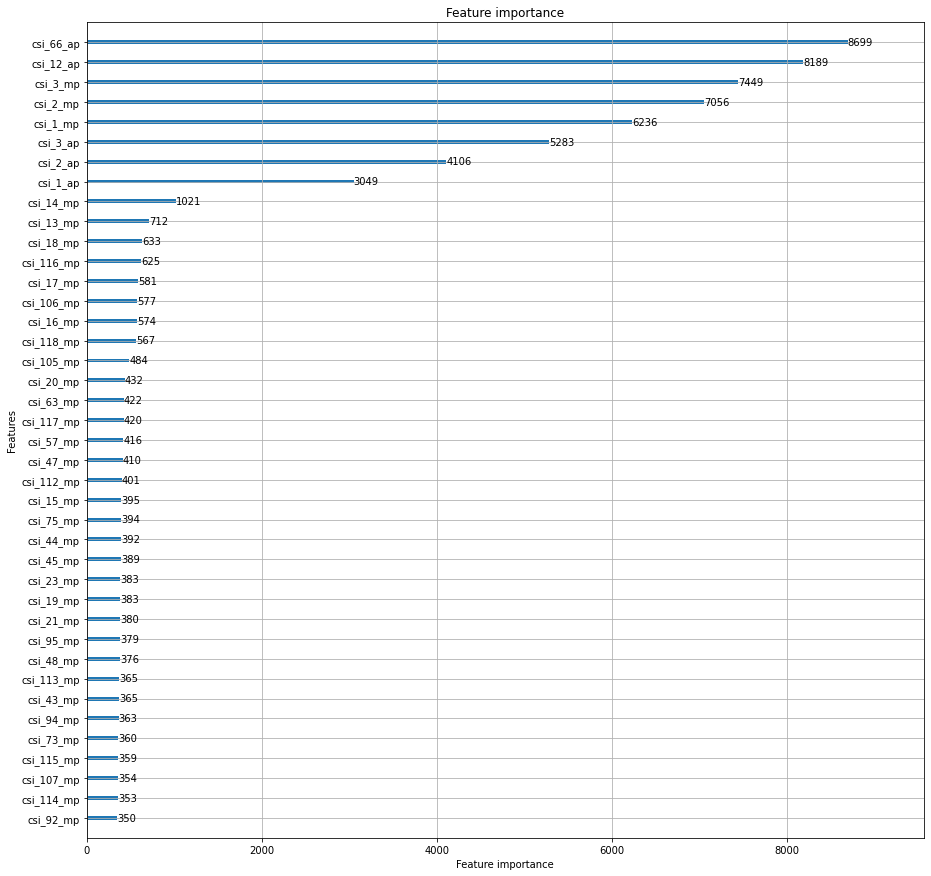

■accuracy
acc : 0.9998


■counts [all : 118087]
corret : 118059 [100%]
non-correct +1 or -1 : 21 [0%]
non-correct +2 or -2 : 7 [0%]
non-correct +3 or -3 : 0 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9998


■zero vs non-zero
■accuracy
accuracy : 1.0


■precision
precision : 1.0


■recall
recall : 1.0


■f1
f1 : 1.0




In [88]:
_prediction_result = main(_df_join_modified_fft)

start!


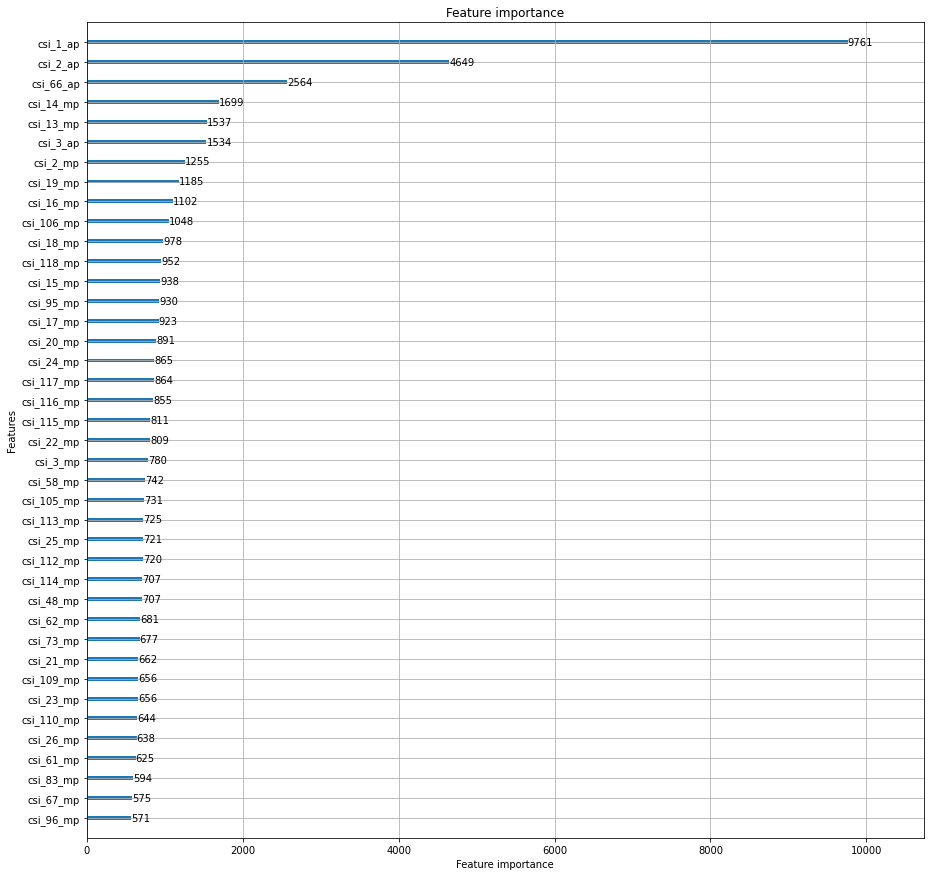

■accuracy
acc : 0.9772


■counts [all : 118087]
corret : 115398 [98%]
non-correct +1 or -1 : 1895 [2%]
non-correct +2 or -2 : 791 [1%]
non-correct +3 or -3 : 2 [0%]
non-correct +4 or -4 : 1 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9776


■zero vs non-zero
■accuracy
accuracy : 1.0


■precision
precision : 1.0


■recall
recall : 1.0


■f1
f1 : 1.0




In [89]:
_prediction_result = main(_df_join_modified_dwt)

fft -> dwt

start!


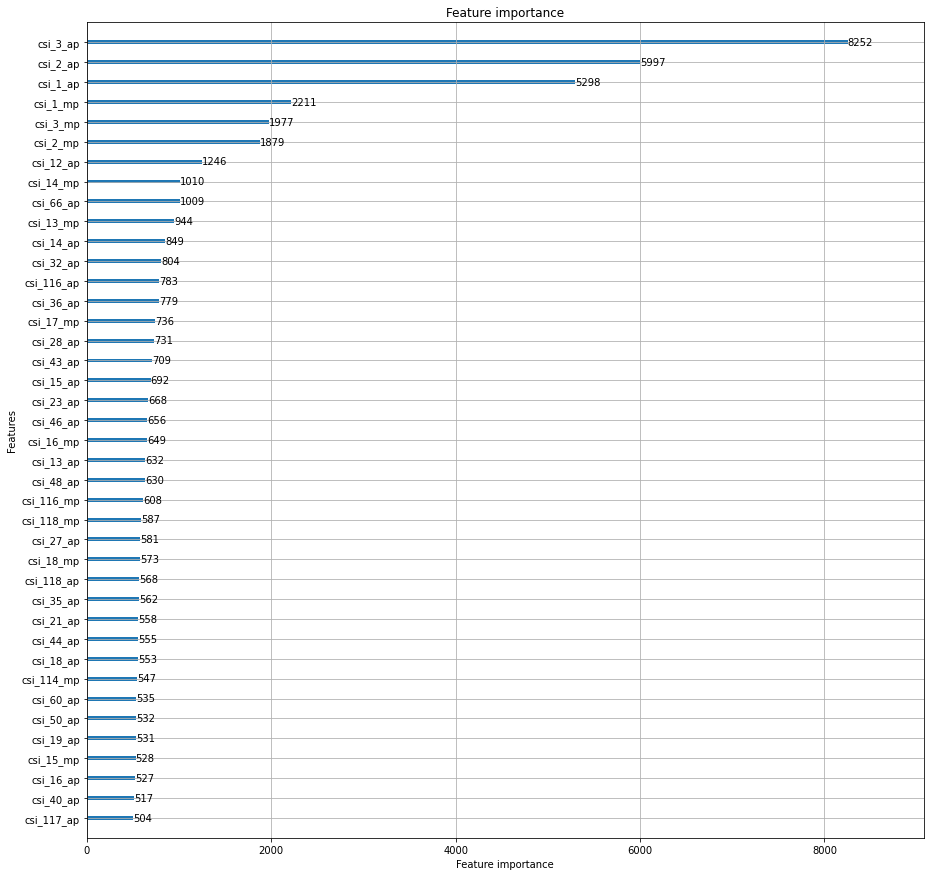

■accuracy
acc : 0.9996


■counts [all : 118087]
corret : 118045 [100%]
non-correct +1 or -1 : 29 [0%]
non-correct +2 or -2 : 11 [0%]
non-correct +3 or -3 : 2 [0%]
non-correct +4 or -4 : 0 [0%]
non-correct +5 or -5 : 0 [0%]
non-correct +6 or -6 : 0 [0%]
■macro_f1
macro_f1: 0.9997


■zero vs non-zero
■accuracy
accuracy : 1.0


■precision
precision : 1.0


■recall
recall : 1.0


■f1
f1 : 1.0




In [132]:
_prediction_result = main(_df_join_modified_fft_dwt)

In [102]:
# _prediction_result = main(_df_join)

In [103]:
#_df_join.head()

なんで低い？

 #### <font color="MediumTurquoise">train と　test が別のデータ用</font>

val と testの境目をなくす。
valなしで、testだけにする

## <font color="Orange">  models</font>

In [108]:
def model_lgb_0127(_X_train, _X_test, _y_train):
    model = lgb.LGBMClassifier(n_jobs=-1, n_estimators=500, class_weight='balanced', random_state=0)
    
    model.fit(_X_train, _y_train)
    
    ax = lgb.plot_importance(model, max_num_features=40, figsize=(15,15))
    plt.show()

##############
### test data
    _y_test_pred = model.predict(_X_test)
    
    _y_test_pred_proba = pd.DataFrame(columns=['proba_0', 'proba_1', 'proba_2', 'proba_3'])
    _y_test_pred_proba_0 =  model.predict_proba(_X_test)[:,0]
    _y_test_pred_proba_1 =  model.predict_proba(_X_test)[:,1]
    _y_test_pred_proba_2 =  model.predict_proba(_X_test)[:,2]
    _y_test_pred_proba_3 =  model.predict_proba(_X_test)[:,3]
    _y_test_pred_proba['proba_0'] = _y_test_pred_proba_0
    _y_test_pred_proba['proba_1'] = _y_test_pred_proba_1
    _y_test_pred_proba['proba_2'] = _y_test_pred_proba_2
    _y_test_pred_proba['proba_3'] = _y_test_pred_proba_3
    
    _y_test_pred_proba = _y_test_pred_proba.to_numpy()
    
#################    
     
    return _y_test_pred, _y_test_pred_proba

## <font color="Orange"> train</font>

In [109]:
def check_accuracy_test_0127(_df, _df_test):

    _X_train = _df.drop(['timestamp','label',], axis=1)
    _y_train = _df['label']
    
######################
## _df_test用
    _X_test = _df_test.drop(['timestamp','label',], axis=1)
    _y_test = _df_test['label']    
######################
    
#     _X_train, _X_val, _y_train,  _y_val = train_test_split(_X, _y, test_size=0.2, random_state=0)
        
    print('start!')
#     print(len(_X_test))

    _y_test_pred, _y_test_pred_proba = model_lgb_0127(_X_train, _X_test, _y_train)


#######################
## _df_test のaccuracy
    
    _y_test = _y_test.to_numpy()

    nums_test = len(_y_test)
    
    ##### counts
    _y_diff_test = np.abs(_y_test - _y_test_pred)
    
    nums_correct_test = np.count_nonzero(_y_diff_test == 0)
    nums_ones_test = np.count_nonzero(_y_diff_test == 1)
    nums_twos_test = np.count_nonzero(_y_diff_test == 2)
    nums_threes_test = np.count_nonzero(_y_diff_test == 3)
    
    print('---- test ----')
    print('■accuracy')
    print('acc : {}'.format(round((nums_correct_test/nums_test), 4)))
    print('\n')
    
    ##### counts
    print('■counts [all : {}]'.format(nums_test))
    print('corret : {} [{}%]'.format(nums_correct_test, round((nums_correct_test/nums_test)*100)))
    print('non-correct +1 or -1 : {} [{}%]'.format(nums_ones_test, round((nums_ones_test/nums_test)*100)))
    print('non-correct +2 or -2 : {} [{}%]'.format(nums_twos_test, round((nums_twos_test/nums_test)*100)))
    print('non-correct +3 or -3 : {} [{}%]'.format(nums_threes_test, round((nums_threes_test/nums_test)*100)))
    
#     #zero vs non-zero
    _y_test_vszero = np.where(_y_test < 1, 0, 1)
    _y_test_pred_vszero = np.where(_y_test_pred < 1, 0, 1)
    
    ##### multi-class logloss
    
#    logloss = log_loss(_y_test, _y_test_pred_proba)
#    print('■multi-class logloss')
#    print('multi-class logloss:{}'.format(round(logloss,4)))
#    print('\n')
    
    ##### mean-f1, macro-f1, micro-f1
    
#    display(_y_test)
#    display(_y_test_pred)
    
#    _y_test = pd.DataFrame(_y_test)
#    _y_test_pred = pd.DataFrame(_y_test_pred)
    _y_test = pd.get_dummies(_y_test).to_numpy()
    _y_test_pred = pd.get_dummies(_y_test_pred).to_numpy()
        
#    mean_f1 = f1_score(_y_test, _y_test_pred, average='samples')
#    macro_f1 = f1_score(_y_test, _y_test_pred, average='macro') 
#    micro_f1 = f1_score(_y_test, _y_test_pred, average='micro')

#    print('■mean_f1')
#    print('mean_f1: {}'.format(round(mean_f1,4)))
#    print('■macro_f1')
#    print('macro_f1: {}'.format(round(macro_f1,4)))
#    print('■micro_f1')
#    print('micro_f1: {}'.format(round(micro_f1,4)))
#    print('\n')
    
    ##### zero vs non-zero
    print('■zero vs non-zero') 
    print('■accuracy')
    print('accuracy : {}'.format(round(accuracy_score(_y_test_vszero, _y_test_pred_vszero),4)))
    print('\n')
    
    ##### precision 
    precision = precision_score(_y_test_vszero, _y_test_pred_vszero)
    print('■precision')
    print('precision : {}'.format(round(precision,4)))
    print('\n')
    
    ##### recall
    recall = recall_score(_y_test_vszero, _y_test_pred_vszero)
    print('■recall')
    print('recall : {}'.format(round(recall,4)))
    print('\n')
    
    ##### F1
    f1 = f1_score(_y_test_vszero, _y_test_pred_vszero)
    print('■f1')
    print('f1 : {}'.format(round(f1,4)))
    print('\n')
    
#################
    return

In [110]:
def main_0127(_df,_df_test):
    check_accuracy_test_0127(_df, _df_test)
    
#     evaluation_output(_prediction_result)
    
#     return _prediction_result
    return 0

In [152]:
_df_ap_modified_fft = _fft_and_filtering(_df_ap, 10)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


start!


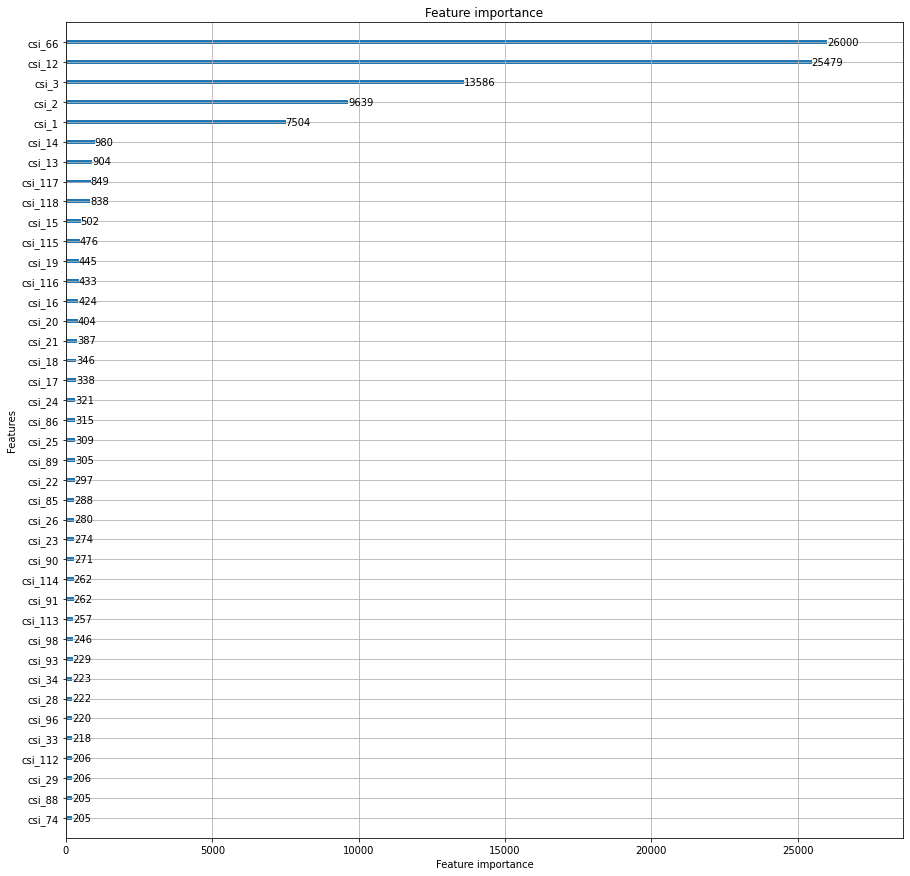

---- test ----
■accuracy
acc : 0.0


■counts [all : 899]
corret : 0 [0%]
non-correct +1 or -1 : 0 [0%]
non-correct +2 or -2 : 240 [27%]
non-correct +3 or -3 : 240 [27%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [153]:
_prediction_result = main_0127(_df_ap_modified_fft, _df_ap0127)

In [181]:
_df_ap_modified_fft = _fft_and_filtering(_df_ap, 10)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


start!


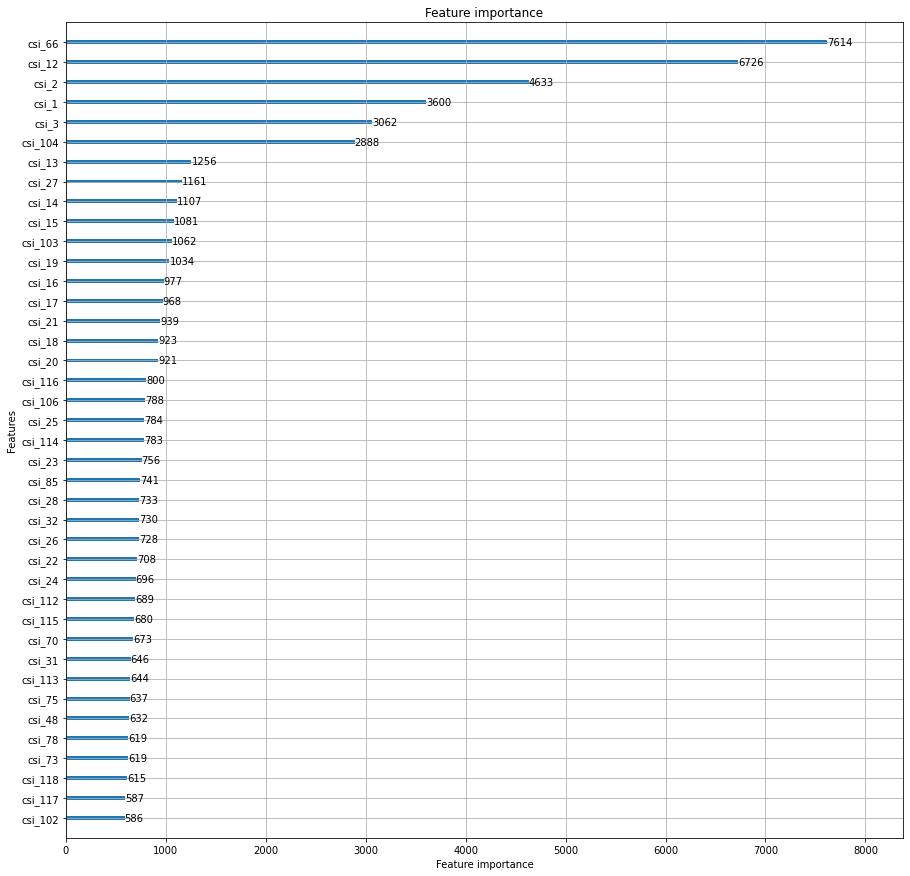

---- test ----
■accuracy
acc : 0.1969


■counts [all : 899]
corret : 177 [20%]
non-correct +1 or -1 : 404 [45%]
non-correct +2 or -2 : 241 [27%]
non-correct +3 or -3 : 53 [6%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [182]:
_prediction_result = main_0127(_df_ap_modified_fft, _df_ap0127)

In [ ]:
_df_ap_modified_fft = _fft_and_filtering(_df_ap, 20)

start!


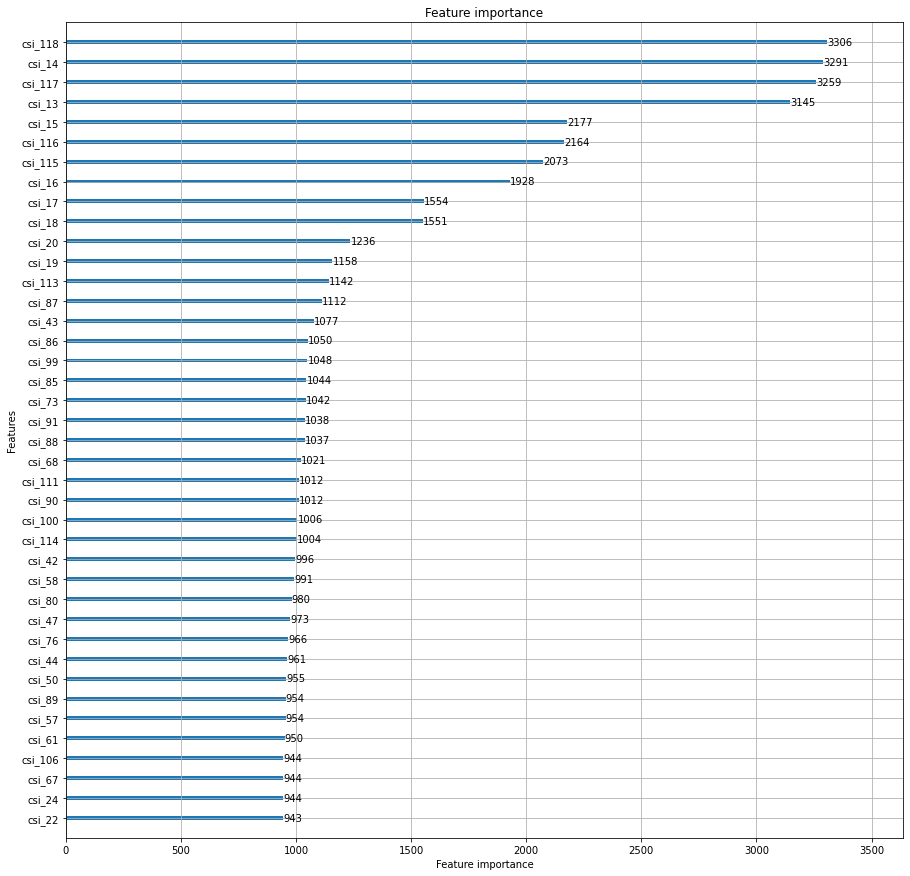

---- test ----
■accuracy
acc : 0.2625


■counts [all : 899]
corret : 236 [26%]
non-correct +1 or -1 : 238 [26%]
non-correct +2 or -2 : 243 [27%]
non-correct +3 or -3 : 181 [20%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [146]:
_prediction_result = main_0127(_df_ap, _df_ap0127)

start!


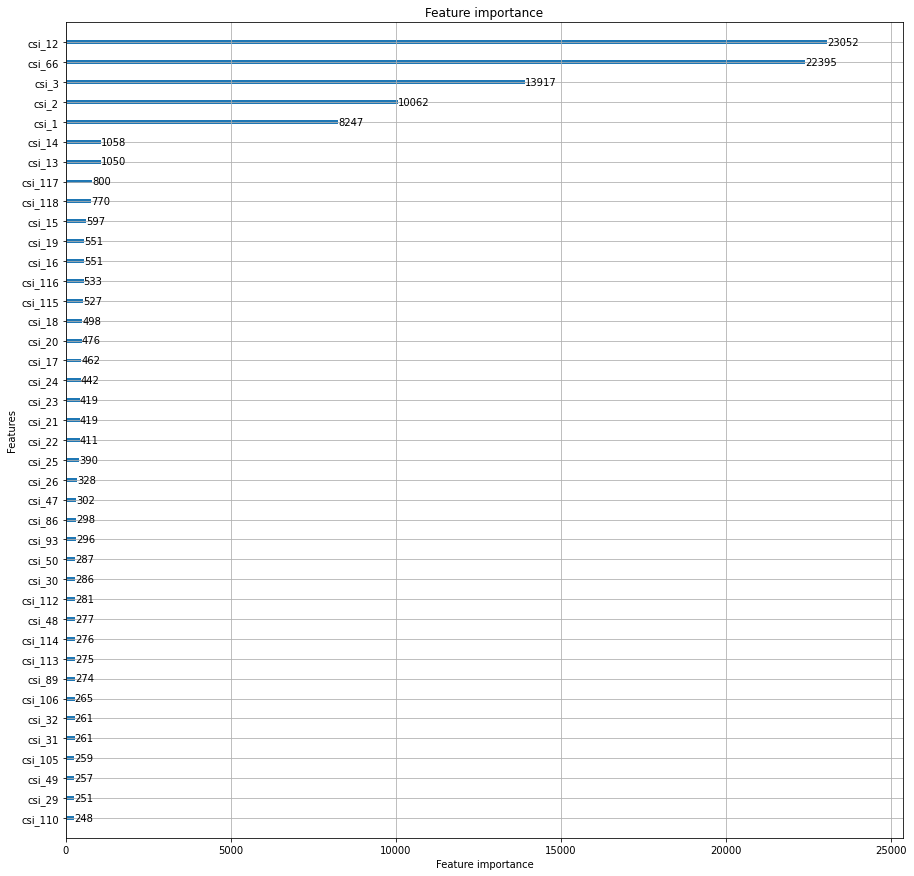

---- test ----
■accuracy
acc : 0.0


■counts [all : 899]
corret : 0 [0%]
non-correct +1 or -1 : 0 [0%]
non-correct +2 or -2 : 240 [27%]
non-correct +3 or -3 : 240 [27%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [145]:
_prediction_result = main_0127(_df_ap_modified_fft, _df_ap0127)

start!


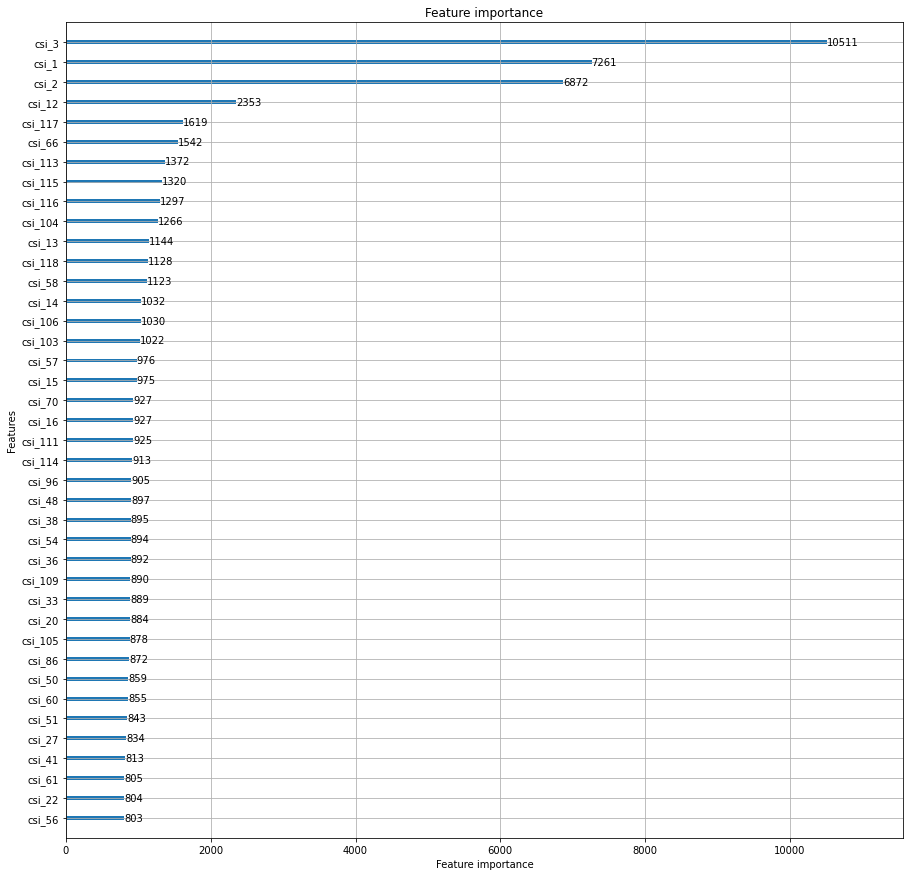

---- test ----
■accuracy
acc : 0.0


■counts [all : 899]
corret : 0 [0%]
non-correct +1 or -1 : 0 [0%]
non-correct +2 or -2 : 0 [0%]
non-correct +3 or -3 : 240 [27%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [147]:
_prediction_result = main_0127(_df_ap_modified_fft_dwt, _df_ap0127)

start!


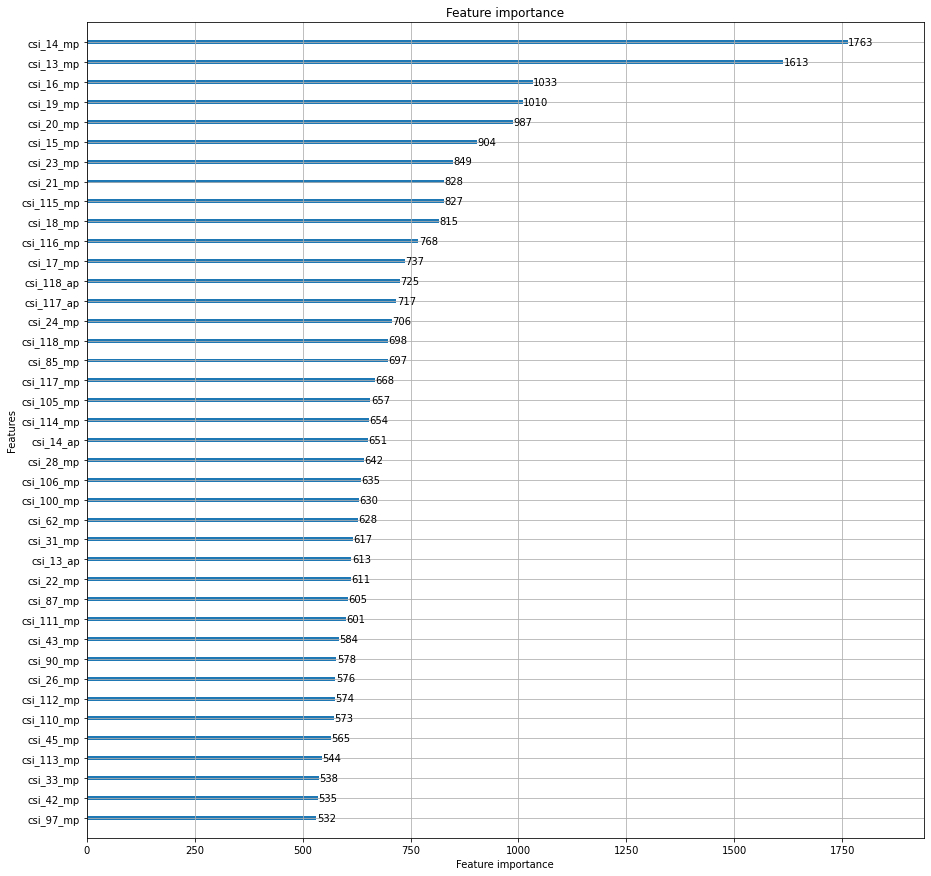

---- test ----
■accuracy
acc : 0.0


■counts [all : 181873]
corret : 0 [0%]
non-correct +1 or -1 : 36425 [20%]
non-correct +2 or -2 : 81691 [45%]
non-correct +3 or -3 : 24231 [13%]
■zero vs non-zero
■accuracy
accuracy : 0.963


■precision
precision : 1.0


■recall
recall : 0.963


■f1
f1 : 0.9811




In [111]:
_prediction_result = main_0127(_df_join_04, _df_join_56)

start!


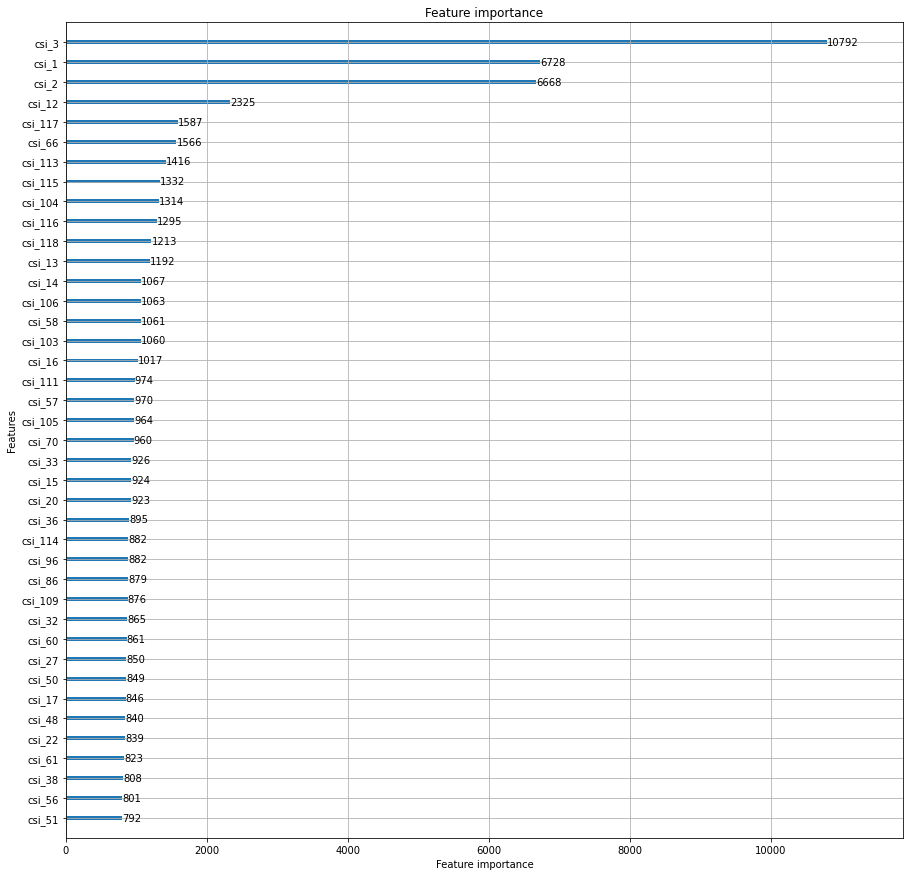

---- test ----
■accuracy
acc : 0.0


■counts [all : 899]
corret : 0 [0%]
non-correct +1 or -1 : 0 [0%]
non-correct +2 or -2 : 0 [0%]
non-correct +3 or -3 : 240 [27%]
■zero vs non-zero
■accuracy
accuracy : 0.8009


■precision
precision : 0.8009


■recall
recall : 1.0


■f1
f1 : 0.8894




In [151]:
_prediction_result = main_0127(_df_ap_modified_fft_dwt, _df_ap0127)

---------------------------------------------------------------

#### <font color="MediumTurquoise">regression用</font>

## <font color="Orange">  models</font>

## <font color="Orange"> train</font>

In [113]:
def model_lgbm_reg(_df):

    X = _df.drop(['timestamp','label'], axis=1)
    y = _df['label']

    X_train, X_test, y_train,  y_test = train_test_split(X, y, test_size=0.2, random_state=0)

    # create dataset for lightgbm
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_test, y_test, reference=lgb_train)
    # LightGBM parameters
    params = {
            'task' : 'train',
            'boosting_type' : 'gbdt',
            'objective' : 'regression',
            'metric' : {'l2'},
            'num_leaves' : 31,
            'learning_rate' : 0.1,
            'feature_fraction' : 0.9,
            'bagging_fraction' : 0.8,
            'bagging_freq': 5,
            'verbose' : 0
    }

    # train
    gbm = lgb.train(params,
                lgb_train,
                num_boost_round=100,
                valid_sets=lgb_eval,
                early_stopping_rounds=10)
    y_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)
    
    ax = lgb.plot_importance(model, max_num_features=40, figsize=(15,15))
    plt.show()

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print(rmse)
    
    sns.violinplot(x=y_test, y=y_pred)
    sns.regplot(y_test, y_test)


In [114]:
model_lgbm_reg(_df_join)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.167009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[1]	valid_0's l2: 3.1774
Training until validation scores don't improve for 10 rounds
[2]	valid_0's l2: 2.98925
[3]	valid_0's l2: 2.83103
[4]	valid_0's l2: 2.69501
[5]	valid_0's l2: 2.58553
[6]	valid_0's l2: 2.50317
[7]	valid_0's l2: 2.41469
[8]	valid_0's l2: 2.33584
[9]	valid_0's l2: 2.28025
[10]	valid_0's l2: 2.21696
[11]	valid_0's l2: 2.16473
[12]	valid_0's l2: 2.11224
[13]	valid_0's l2: 2.06557
[14]	valid_0's l2: 2.02687
[15]	valid_0's l2: 1.99023
[16]	valid_0's l2: 1.96077
[17]	valid_0's l2: 1.92516
[18]	valid_0's l2: 1.89671
[19]	valid_0's l2: 1.87365
[20]	valid_0's l2: 1.84387
[21]	valid_0's l2: 1.82282
[22]	valid_0's l2: 1.80239
[23]	valid_0's l2: 1.77777
[24]	valid_0's l2: 1.75312
[25]	valid_0's l2: 1.7322
[26]	valid_0's l2: 1.71216
[27]	valid_0's l2: 1.68866
[28]	valid_0's l2: 1.66668
[29]	valid_0's l2: 1.64411
[3

NameError: name 'model' is not defined

In [ ]:
model_lgbm_reg(_df_join_modified_fft)

 #### <font color="MediumTurquoise">regression用</font>
 #### <font color="MediumTurquoise">train と　test が別のデータ用</font>

## <font color="Orange">  models</font>

## <font color="Orange"> train</font>

In [119]:
def model_lgbm_reg_dif(_df,_df_test):

    X_train = _df.drop(['timestamp','label'], axis=1)
    y_train = _df['label']

    X_test = _df_test.drop(['timestamp','label'], axis=1)
    y_test = _df_test['label']

    # create dataset for lightgbm
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_test, y_test, reference=lgb_train)
    # LightGBM parameters
    params = {
            'task' : 'train',
            'boosting_type' : 'gbdt',
            'objective' : 'regression',
            'metric' : {'l2'},
            'num_leaves' : 7, #元々30
            'learning_rate' : 0.1,
            'feature_fraction' : 0.5, # 元々0.9
            'bagging_fraction' : 0.8,
            'bagging_freq': 5,
            'verbose' : 0
    }

    # train
    gbm = lgb.train(params,
                lgb_train,
                num_boost_round=100,
                valid_sets=lgb_eval,
                early_stopping_rounds=10)
    y_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)
    
    ax = lgb.plot_importance(gbm, max_num_features=40, figsize=(15,15))
    plt.show()
    

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print('■rmse')
    print('rmse: {}'.format(rmse))
    
#    fig, ax = plt.subplots()
#    ax.boxplot([y_test,
#                y_pred])
#    ax.set_xlabel('test')
#    ax.set_ylabel('pred')
#    plt.show()
    
    
    
    sns.violinplot(x=y_test, y=y_pred)
#    sns.boxplot(x=y_test, y=y_pred)
    sns.regplot(x=[0,1], y=[5,6])


#    sns.regplot(y_test, y_test)

    
#    x = np.arange(0, 6, 0.1)

#    /*0 < y < 20*/
#    y = x

#    /* y = x をグラフにplot*/
#    plt.plot(x, y)

#    /*実際にグラフに出力*/
 #   plt.show()

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.112516 seconds.
You can set `force_col_wise=true` to remove the overhead.
[1]	valid_0's l2: 10.4701
Training until validation scores don't improve for 10 rounds
[2]	valid_0's l2: 10.3122
[3]	valid_0's l2: 10.172
[4]	valid_0's l2: 10.0239
[5]	valid_0's l2: 9.88495
[6]	valid_0's l2: 9.75125
[7]	valid_0's l2: 9.63739
[8]	valid_0's l2: 9.54119
[9]	valid_0's l2: 9.46902
[10]	valid_0's l2: 9.39814
[11]	valid_0's l2: 9.36076
[12]	valid_0's l2: 9.29958
[13]	valid_0's l2: 9.27031
[14]	valid_0's l2: 9.22667
[15]	valid_0's l2: 9.18449
[16]	valid_0's l2: 9.15316
[17]	valid_0's l2: 9.08258
[18]	valid_0's l2: 9.0672
[19]	valid_0's l2: 9.06306
[20]	valid_0's l2: 9.05485
[21]	valid_0's l2: 9.04865
[22]	valid_0's l2: 9.04506
[23]	valid_0's l2: 9.02095
[24]	valid_0's l2: 9.00832
[25]	valid_0's l2: 8.99892
[26]	valid_0's l2: 8.9978
[27]	valid_0's l2: 8.99237
[28]	valid_0's l2: 8.95947
[29]	valid_0's l2: 8.95167
[30

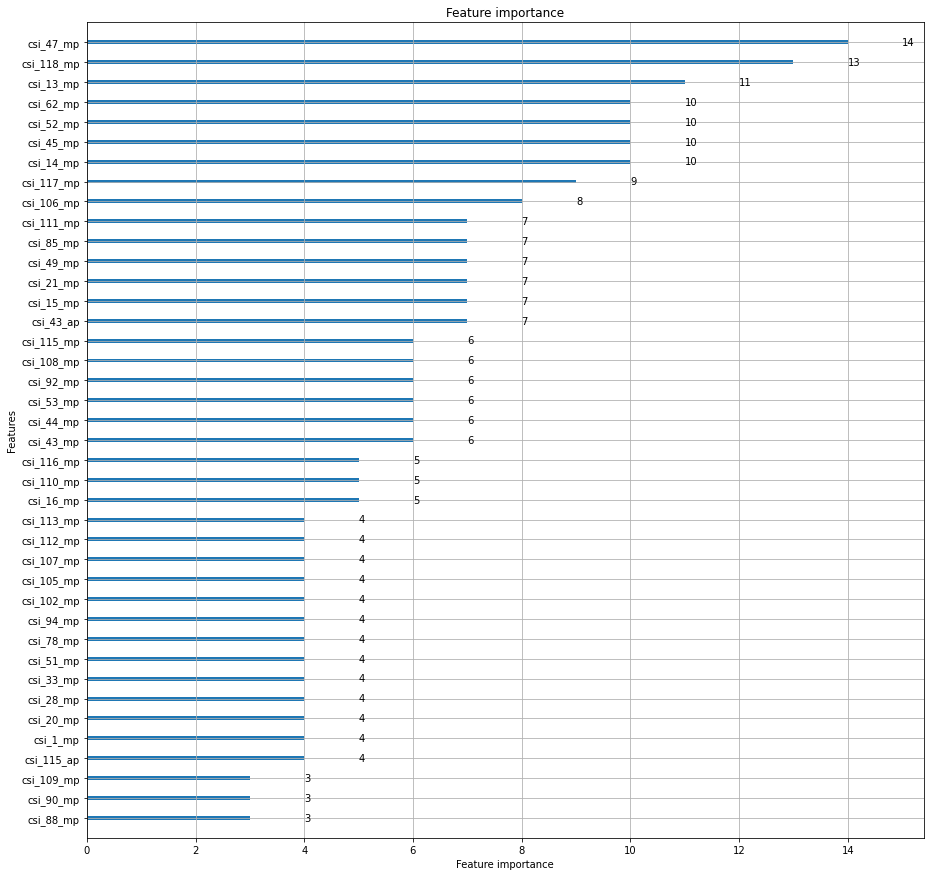

■rmse
rmse: 2.9714706793753027


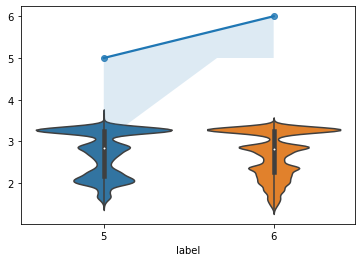

In [120]:
model_lgbm_reg_dif(_df_join_04, _df_join_56)

In [121]:
_df_join_04_modified_fft_20 = _fft_and_filtering(_df_join_04, 20)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.106727 seconds.
You can set `force_col_wise=true` to remove the overhead.
[1]	valid_0's l2: 10.0841
Training until validation scores don't improve for 10 rounds
[2]	valid_0's l2: 10.3032
[3]	valid_0's l2: 10.3325
[4]	valid_0's l2: 9.87733
[5]	valid_0's l2: 9.83133
[6]	valid_0's l2: 9.47516
[7]	valid_0's l2: 9.39019
[8]	valid_0's l2: 9.19891
[9]	valid_0's l2: 9.02963
[10]	valid_0's l2: 8.96843
[11]	valid_0's l2: 8.82606
[12]	valid_0's l2: 8.783
[13]	valid_0's l2: 8.66089
[14]	valid_0's l2: 8.50484
[15]	valid_0's l2: 8.40113
[16]	valid_0's l2: 8.34154
[17]	valid_0's l2: 8.45505
[18]	valid_0's l2: 8.40548
[19]	valid_0's l2: 8.40567
[20]	valid_0's l2: 8.52946
[21]	valid_0's l2: 8.63457
[22]	valid_0's l2: 8.63909
[23]	valid_0's l2: 8.76728
[24]	valid_0's l2: 8.87394
[25]	valid_0's l2: 8.86659
[26]	valid_0's l2: 8.81274
Early stopping, best iteration is:
[16]	valid_0's l2: 8.34154


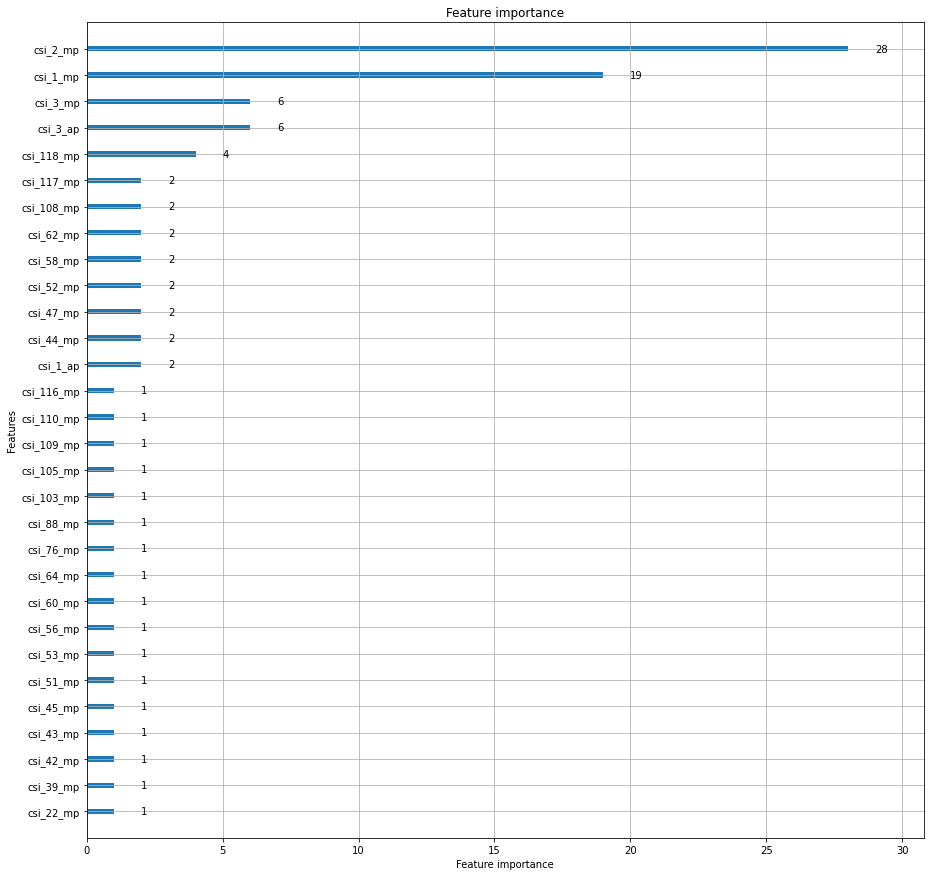

■rmse
rmse: 2.888172935534612


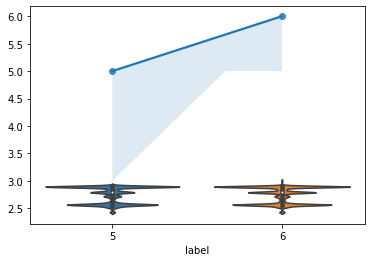

In [123]:
model_lgbm_reg_dif(_df_join_04_modified_fft_20, _df_join_56)

In [124]:
model_lgbm_reg_dif(_df_join_04_modified_dwt, _df_join_56)

NameError: name '_df_join_04_modified_dwt' is not defined

In [125]:
model_lgbm_reg_dif(_df_join_04_modified_fft_dwt, _df_join_56)

NameError: name '_df_join_04_modified_fft_dwt' is not defined

fft フィルタ処理

In [ ]:
_df_join_04_modified_fft_0 = _fft_and_filtering(_df_join_04, 0)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_0, _df_join_56)

In [ ]:
_df_join_04_modified_fft_10 = _fft_and_filtering(_df_join_04, 10)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_10, _df_join_56)

In [ ]:
_df_join_04_modified_fft_20 = _fft_and_filtering(_df_join_04, 20)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_20, _df_join_56)

In [ ]:
_df_join_04_modified_fft_10 = _fft_and_filtering(_df_join_04, 10)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_10, _df_join_56)

In [ ]:
_df_join_04_modified_fft_19 = _fft_and_filtering(_df_join_04, 19)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_19, _df_join_56)

In [ ]:
_df_join_04_modified_fft_20 = _fft_and_filtering(_df_join_04, 20)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_20, _df_join_56)

In [ ]:
_df_join_04_modified_fft_21 = _fft_and_filtering(_df_join_04, 21)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_21, _df_join_56)

In [ ]:
_df_join_04_modified_fft_22 = _fft_and_filtering(_df_join_04, 22)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_22, _df_join_56)

In [ ]:
_df_join_04_modified_fft_23 = _fft_and_filtering(_df_join_04, 23)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_23, _df_join_56)

In [ ]:
_df_join_04_modified_fft_24 = _fft_and_filtering(_df_join_04, 24)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_24, _df_join_56)

In [ ]:
_df_join_04_modified_fft_25 = _fft_and_filtering(_df_join_04, 25)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_25, _df_join_56)

In [ ]:
_df_join_04_modified_fft_30 = _fft_and_filtering(_df_join_04, 30)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_30, _df_join_56)

In [ ]:
_df_join_04_modified_fft_40 = _fft_and_filtering(_df_join_04, 40)

In [ ]:
model_lgbm_reg_dif(_df_join_04_modified_fft_40, _df_join_56)

#### 

xgboost
NN
SVM
EDA

フィルタ処理
 してどうにかなるもんじゃないな
 
ハイパラチューニング

 #### <font color="MediumTurquoise">regression用</font>
 #### <font color="MediumTurquoise">train と　test が別のデータ用</font>

## <font color="Orange">  models</font>

## <font color="Orange"> train</font>

 #### <font color="MediumTurquoise">xgboost</font>

In [ ]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import load_boston
from sklearn.metrics import mean_squared_error

In [ ]:
def model_xgb_reg_dif(_df,_df_test):

    X_train = _df.drop(['timestamp','label'], axis=1)
    y_train = _df['label']

    X_test = _df_test.drop(['timestamp','label'], axis=1)
    y_test = _df_test['label']


    # xgboostモデルの作成
    reg = lgb.LGBMClassifier()
    
    # ハイパーパラメータ探索
    reg_cv = GridSearchCV(reg, {'max_depth': [2,4,6], 'n_estimators': [50,100,200]}, verbose=1)
    reg_cv.fit(X_train, y_train)
    print(reg_cv.best_params_, reg_cv.best_score_)
    
    # 改めて最適パラメータで学習
    reg = xgb.XGBRegressor(**reg_cv.best_params_)
    reg.fit(X_train, y_train)
    
    # 学習モデルの評価
    pred_train = reg.predict(X_train)
    pred_test = reg.predict(X_test)
    mse_train = mean_squared_error(y_train, pred_train)
    mse_test = mean_squared_error(y_test, pred_test)
    rmse_train = np.sqrt(mse_train)
    rmse_test = np.sqrt(mse_test)
    
    print(rmse_train)
    print(rmse_test)
    print('■rmse')
    print('rmse_train: {}'.format(rmse_train))
    print('rmse_test: {}'.format(rmse_test))
    
#    fig, ax = plt.subplots()
#    ax.boxplot([y_test,
#                y_pred])
#    ax.set_xlabel('test')
#    ax.set_ylabel('pred')
#    plt.show()

    
    ax = lgb.plot_importance(model, max_num_features=40, figsize=(15,15))
    plt.show()
    
    
    sns.violinplot(x=y_test, y=pred_test)
#    sns.boxplot(x=y_test, y=y_pred)
    sns.regplot(x=[0,1], y=[5,6])
    
    
    
    importances = pd.Series(reg.feature_importances_, index = boston.feature_names)
    importances = importances.sort_values()
    importances.plot(kind = "barh")
    plt.title("imporance in the xgboost Model")
    plt.show()


#    sns.regplot(y_test, y_test)

    
#    x = np.arange(0, 6, 0.1)

#    /*0 < y < 20*/
#    y = x

#    /* y = x をグラフにplot*/
#    plt.plot(x, y)

#    /*実際にグラフに出力*/
 #   plt.show()

In [ ]:
model_xgb_reg_dif(_df_join_04, _df_join_56)

 #### <font color="MediumTurquoise">regression用</font>
 #### <font color="MediumTurquoise">train と　test が別のデータ用</font>

## <font color="Orange">  models</font>

## <font color="Orange"> train</font>

 #### <font color="MediumTurquoise">lightgbm gridsearch付き</font>

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

In [ ]:
def model_lgb_reg_dif_grid(_df,_df_test):

    X_train = _df.drop(['timestamp','label'], axis=1)
    y_train = _df['label']

    X_test = _df_test.drop(['timestamp','label'], axis=1)
    y_test = _df_test['label']


    # xgboostモデルの作成
    reg = lgb.XGBRegressor()
    
    # ハイパーパラメータ探索
    reg_cv = GridSearchCV(reg, {'max_depth': [2,4,6], 'n_estimators': [50,100,200]}, verbose=1)
    reg_cv.fit(X_train, y_train)
    print(reg_cv.best_params_, reg_cv.best_score_)
    
    # 改めて最適パラメータで学習
    reg = xgb.XGBRegressor(**reg_cv.best_params_)
    reg.fit(X_train, y_train)
    

    
    # create dataset for lightgbm
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_test, y_test, reference=lgb_train)
    # LightGBM parameters
    params = {
            'task' : 'train',
            'boosting_type' : 'gbdt',
            'objective' : 'regression',
            'metric' : {'l2'},
            'num_leaves' : 7, #元々30
            'learning_rate' : 0.1,
            'feature_fraction' : 0.5, # 元々0.9
            'bagging_fraction' : 0.8,
            'bagging_freq': 5,
            'verbose' : 0
    }
    
    
    

    # train
    gbm = lgb.train(params,
                lgb_train,
                num_boost_round=100,
                valid_sets=lgb_eval,
                early_stopping_rounds=10)
    y_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print('■rmse')
    print('rmse: {}'.format(rmse))
    
    
    
#    fig, ax = plt.subplots()
#    ax.boxplot([y_test,
#                y_pred])
#    ax.set_xlabel('test')
#    ax.set_ylabel('pred')
#    plt.show()

    
    
    
    
    sns.violinplot(x=y_test, y=pred_test)
#    sns.boxplot(x=y_test, y=y_pred)
    sns.regplot(x=[0,1], y=[5,6])
    
    
    
    importances = pd.Series(reg.feature_importances_, index = boston.feature_names)
    importances = importances.sort_values()
    importances.plot(kind = "barh")
    plt.title("imporance in the xgboost Model")
    plt.show()


#    sns.regplot(y_test, y_test)

    
#    x = np.arange(0, 6, 0.1)

#    /*0 < y < 20*/
#    y = x

#    /* y = x をグラフにplot*/
#    plt.plot(x, y)

#    /*実際にグラフに出力*/
 #   plt.show()

In [ ]:
model_xgb_reg_dif(_df_join_04, _df_join_56)

lightgbmのfeature importanceが高かった特徴量だけを入れて、汎化性能が高くなるかをみる。